# Finding blobs in 64x64 images using Unet, Conv3d

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
from PIL import Image
import random
import utils

In [2]:
data='/media/smc/RNAFish/DeepLearning/'

# Get data

Load data from file

In [3]:
shp=[1,256,256,7]

In [4]:
train_both=utils.get_raw_float_image(data+'Training.raw',shp)
validation_both=utils.get_raw_float_image(data+'Validation.raw', shp)

In [5]:
train_data=train_both[:,:,:,[0]]/4096.0
#train_data=train_both[:,:,:,[4]]/255.0
train_truth=np.stack((train_both[:,:,:,[4]]/255.0, 1-train_both[:,:,:,[4]]/255.0), axis=3)
train_truth=train_both[:,:,:,[4]]/255.0

In [6]:
validation_data=validation_both[:,:,:,[0]]/4096.0
#validation_data=validation_both[:,:,:,[4]]/255.0
validation_truth=np.stack((validation_both[:,:,:,[4]]/255.0, 1-validation_both[:,:,:,[4]]/255.0), axis=3)
validation_truth=validation_both[:,:,:,[4]]/255.0

# Parse data

Mix the two datasets (rotated truths, normal images) and get training/validation sets

# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [11]:
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, 256,256,1])
y=tf.placeholder(dtype=tf.float32, shape=[None, 256,256,1])

xr=x
yr=y

base_scaler=32

#Going down
A1=(tf.layers.conv2d(xr, base_scaler, [5,5], padding='SAME'))
A2=(tf.layers.conv2d(A1, base_scaler, [3,3], padding='SAME'))

B0=tf.nn.max_pool(A2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
B1=(tf.layers.conv2d(B0, 2*base_scaler, [3,3], padding='SAME'))
B2=(tf.layers.conv2d(B1, 2*base_scaler, [3,3], padding='SAME'))

C0=tf.nn.max_pool(B2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
C1=(tf.layers.conv2d(C0, 4*base_scaler, [3,3], padding='SAME'))
C2=(tf.layers.conv2d(C1, 4*base_scaler, [3,3], padding='SAME'))

D0=tf.nn.max_pool(C2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
D1=(tf.layers.conv2d(D0, 8*base_scaler, [3,3], padding='SAME'))
D2=(tf.layers.conv2d(D1, 8*base_scaler, [3,3], padding='SAME'))

E0=tf.nn.max_pool(D2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
E1=(tf.layers.conv2d(E0, 16*base_scaler, [3,3], padding='SAME'))
E2=(tf.layers.conv2d(E1, 16*base_scaler, [3,3], padding='SAME'))

F0=tf.nn.max_pool(E2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
F1=(tf.layers.conv2d(F0, 16*base_scaler, [3,3], padding='SAME'))
F2=(tf.layers.conv2d(F1, 16*base_scaler, [3,3], padding='SAME'))



#Coming up
EE0=tf.layers.conv2d_transpose(F2, 8*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
EE1=tf.concat(axis=3, values=[EE0,E2])
EE2=(tf.layers.conv2d(EE1, 8*base_scaler, [3,3], padding='SAME'))
EE3=(tf.layers.conv2d(EE2, 8*base_scaler, [3,3], padding='SAME'))

DD0=tf.layers.conv2d_transpose(EE2, 8*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
DD1=tf.concat(axis=3, values=[DD0,D2])
DD2=(tf.layers.conv2d(DD1, 8*base_scaler, [3,3], padding='SAME'))
DD3=(tf.layers.conv2d(DD2, 8*base_scaler, [3,3], padding='SAME'))

CC0=tf.layers.conv2d_transpose(DD3, 4*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
CC1=tf.concat(axis=3, values=[CC0,C2])
CC2=(tf.layers.conv2d(CC1, 4*base_scaler, [3,3], padding='SAME'))
CC3=(tf.layers.conv2d(CC2, 4*base_scaler, [3,3], padding='SAME'))

BB0=tf.layers.conv2d_transpose(CC3, 2*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
#BB0=tf.contrib.layers.conv2d_transpose(C2, 2*base_scaler, kernel_size=[3,3], stride=[2, 2], padding='SAME')
BB1=tf.concat(axis=3, values=[BB0,B2])
BB2=(tf.layers.conv2d(BB1, 2*base_scaler, [3,3], padding='SAME'))
BB3=(tf.layers.conv2d(BB2, 2*base_scaler, [3,3], padding='SAME'))

AA0=tf.layers.conv2d_transpose(BB3, base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
AA1=tf.concat(axis=3, values=[AA0,A2])
AA2=(tf.layers.conv2d(AA1, base_scaler, [3,3], padding='SAME'))
AA3=(tf.layers.conv2d(AA2, base_scaler, [3,3], padding='SAME'))

logits=tf.nn.relu(tf.layers.conv2d(AA3, 1, [1,1], padding='SAME'))
#flattened_logits= tf.reshape(tensor=logits, shape=(-1, 2))

#flattened_yr=tf.reshape(tensor=yr, shape=(-1, 2))

#cross_entropies = tf.nn.softmax_cross_entropy_with_logits_v2(logits=flattened_logits,
#                                                          labels=tf.stop_gradient(flattened_yr))

#cross_entropy_sum = tf.reduce_sum(cross_entropies)

probs = tf.tanh(logits)

pos=1000*tf.multiply(tf.log(1e-15+probs),yr)
neg=tf.multiply(tf.log(1-probs+1e-15),1-yr)

loss=-tf.reduce_mean(pos)-tf.reduce_mean(neg)


                        
#OLD BAD
#probs=tf.tanh(logits)

#diff=tf.subtract(probs, yr)
#LSQ=tf.multiply(diff,diff)
#Added this to make the outlines more potent in error function
#OutError, MaskError=tf.split(LSQ, [1,1], 3)
#loss=10*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
#loss=tf.reduce_mean(LSQ)
#END OLD BAD

#train_op=tf.train.AdamOptimizer(learning_rate=0.001).minimize(cross_entropy_sum)
train_op=tf.train.AdamOptimizer(learning_rate=0.0001).minimize(loss)

# Training on easy set

0
Training loss:  0.261646
(50, 256, 256, 1)
Validation loss:  0.151746


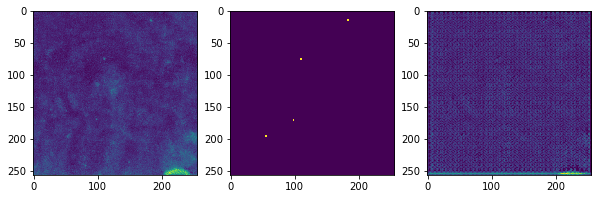

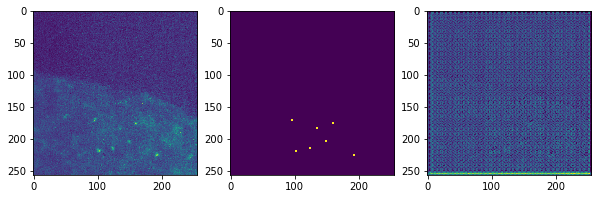

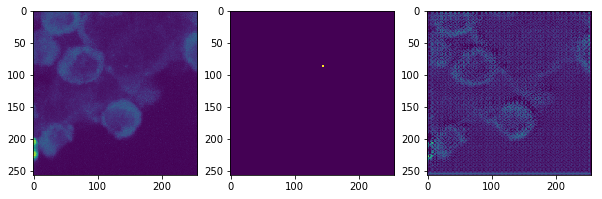

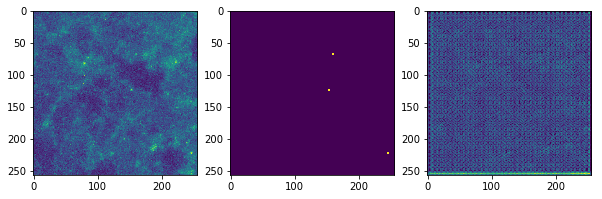

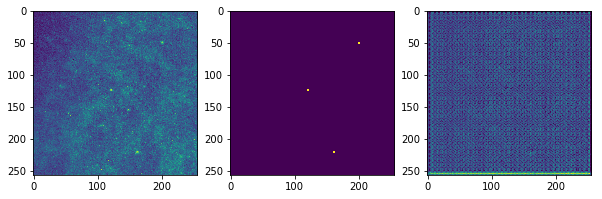

30
Training loss:  0.153936
(50, 256, 256, 1)
Validation loss:  0.0994709


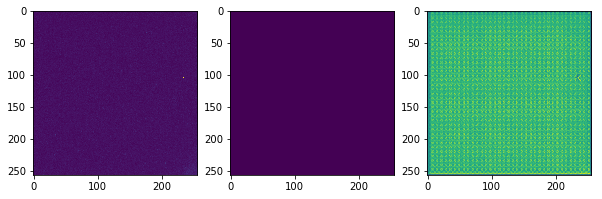

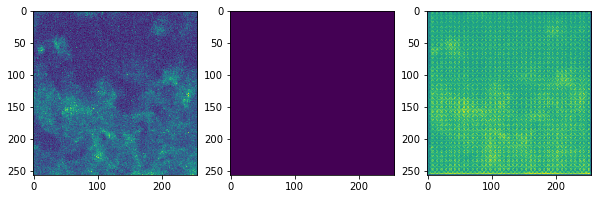

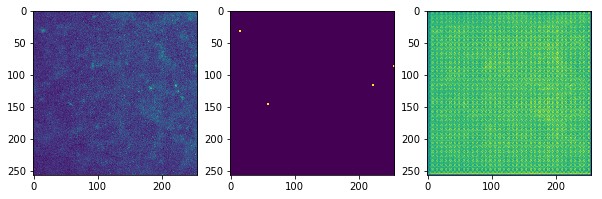

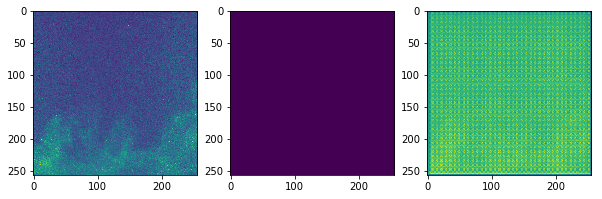

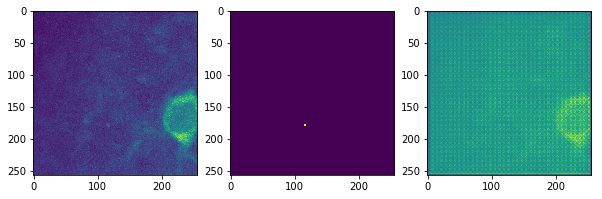

60
Training loss:  0.140631
(50, 256, 256, 1)
Validation loss:  0.110677


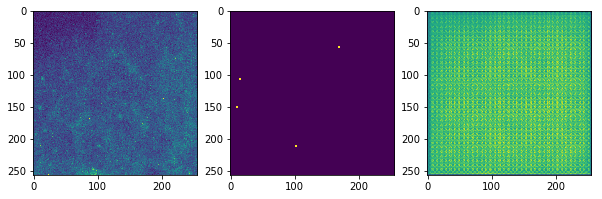

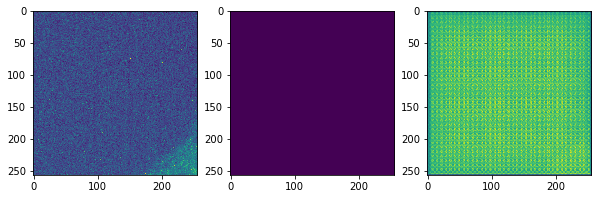

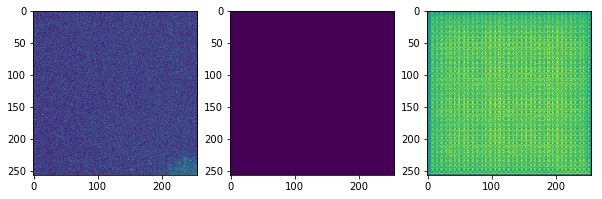

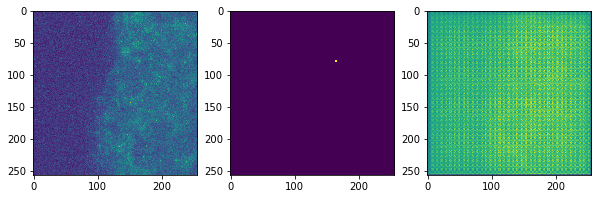

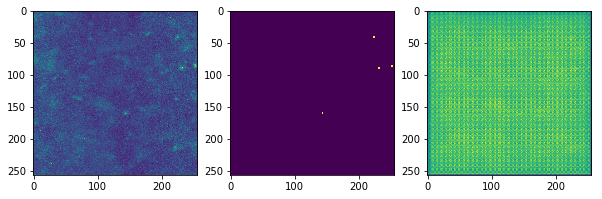

90
Training loss:  0.127572
(50, 256, 256, 1)
Validation loss:  0.0857821


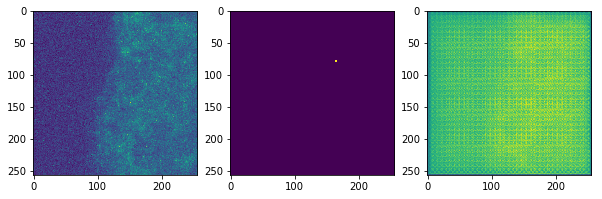

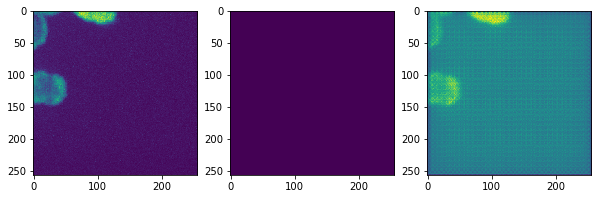

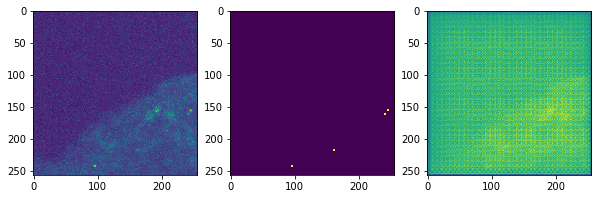

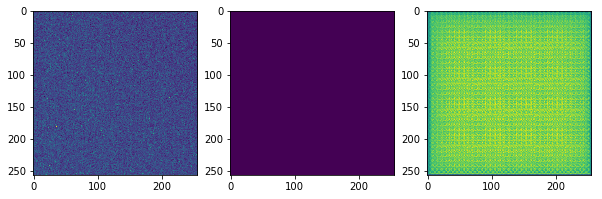

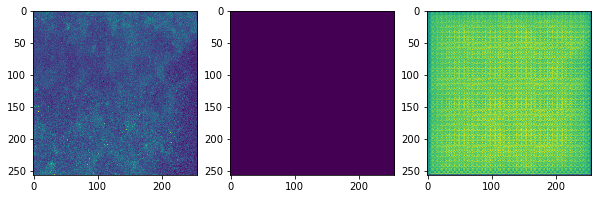

120
Training loss:  0.149623
(50, 256, 256, 1)
Validation loss:  0.106317


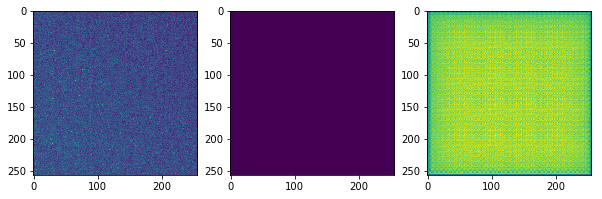

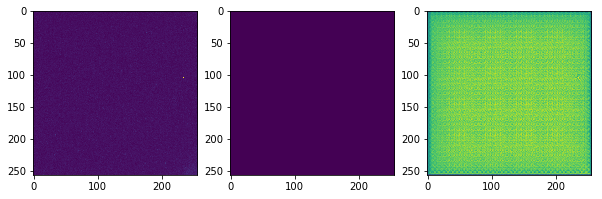

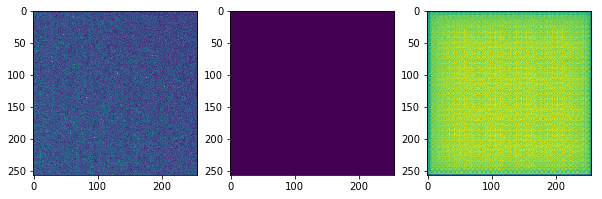

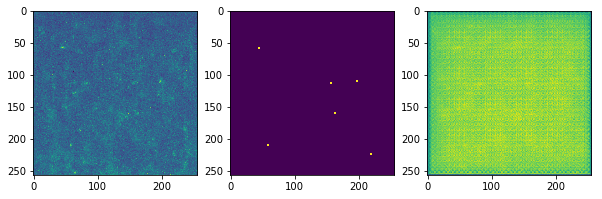

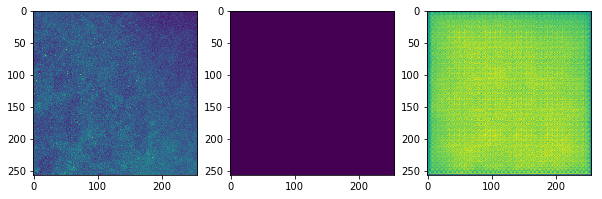

150
Training loss:  0.17289
(50, 256, 256, 1)
Validation loss:  0.10481


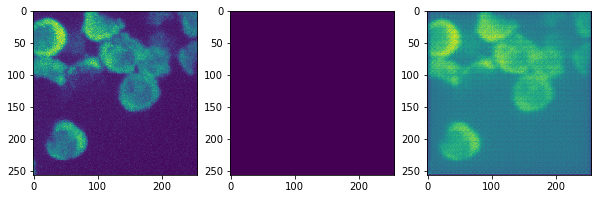

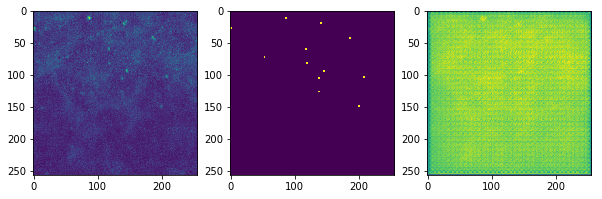

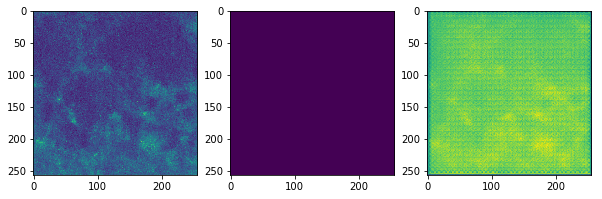

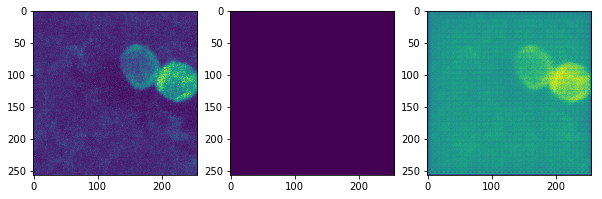

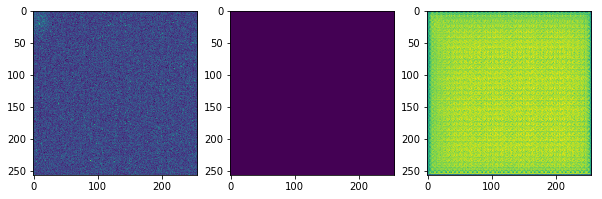

180
Training loss:  0.179476
(50, 256, 256, 1)
Validation loss:  0.0850271


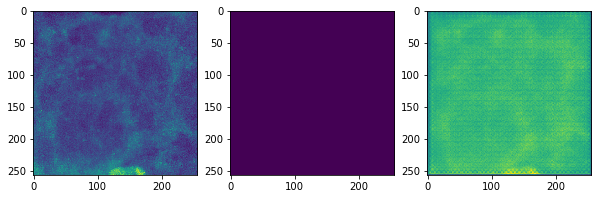

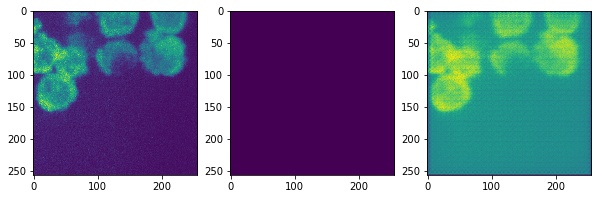

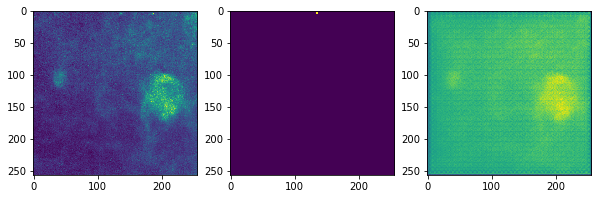

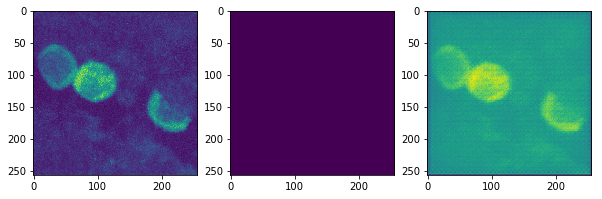

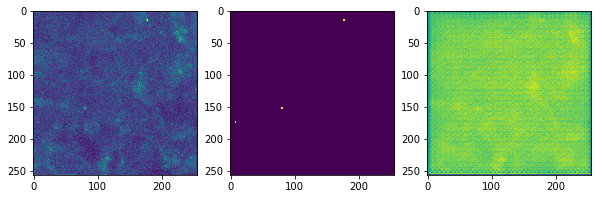

210
Training loss:  0.179788
(50, 256, 256, 1)
Validation loss:  0.0970349


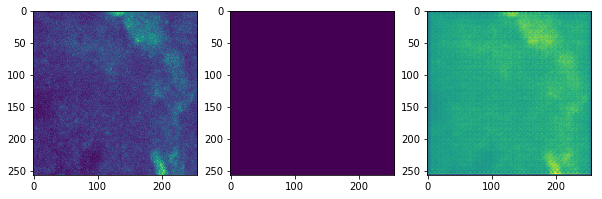

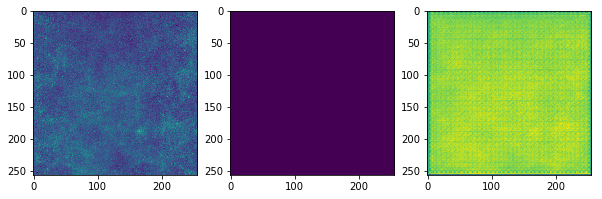

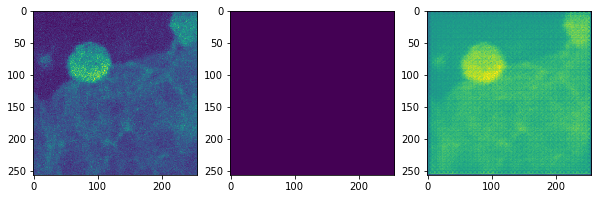

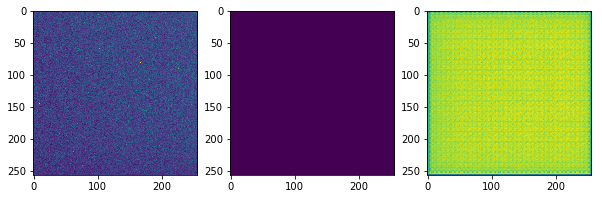

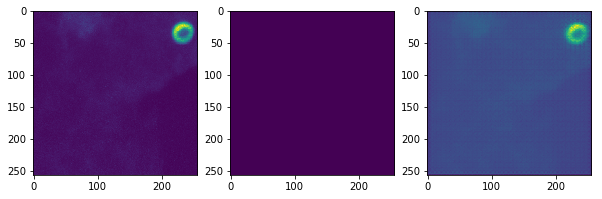

240
Training loss:  0.0998419
(50, 256, 256, 1)
Validation loss:  0.109159


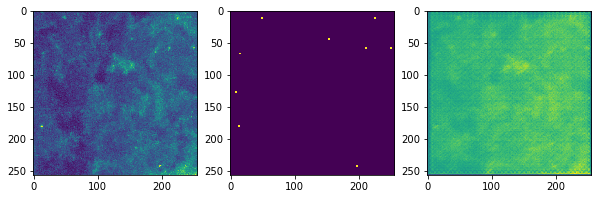

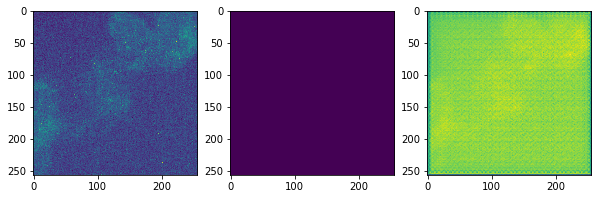

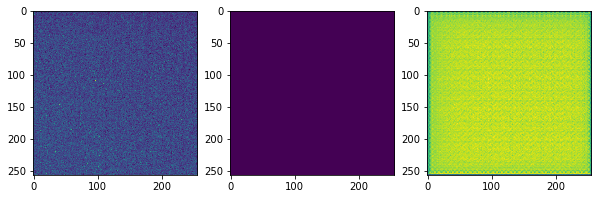

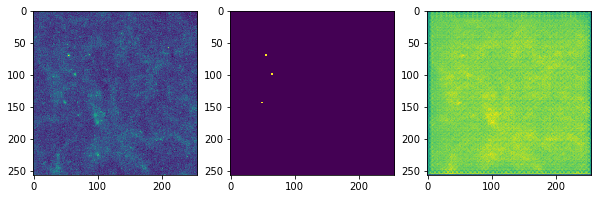

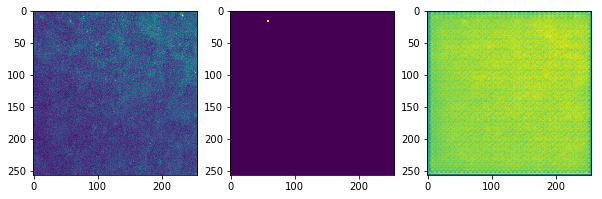

270
Training loss:  0.153369
(50, 256, 256, 1)
Validation loss:  0.0991526


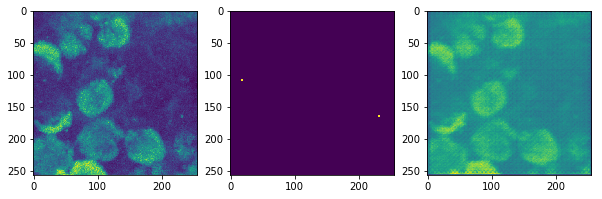

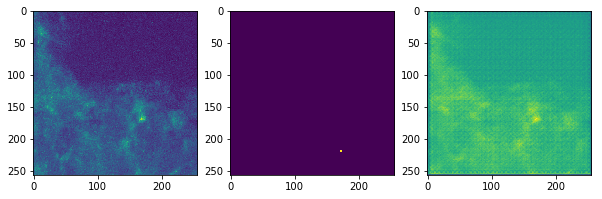

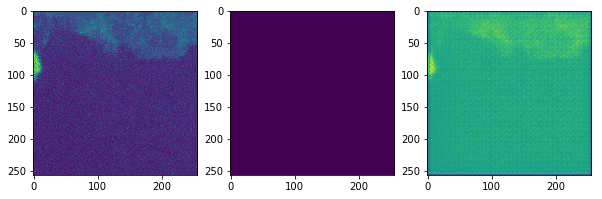

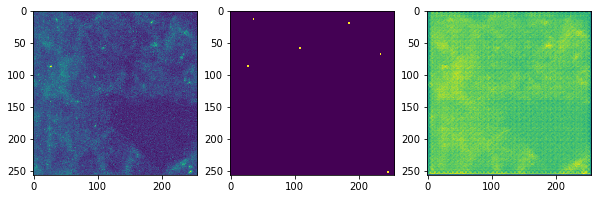

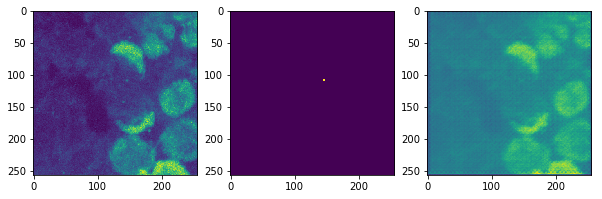

300
Training loss:  0.131506
(50, 256, 256, 1)
Validation loss:  0.101371


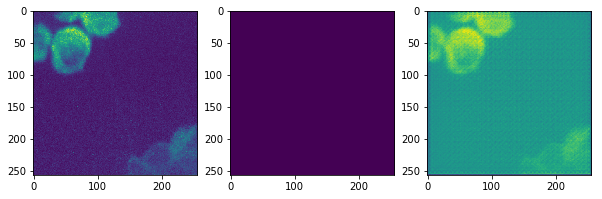

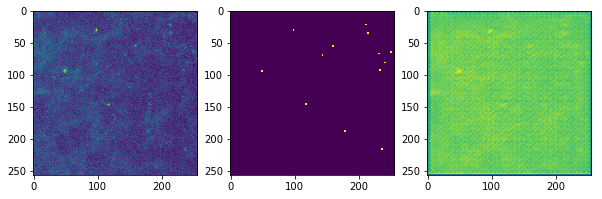

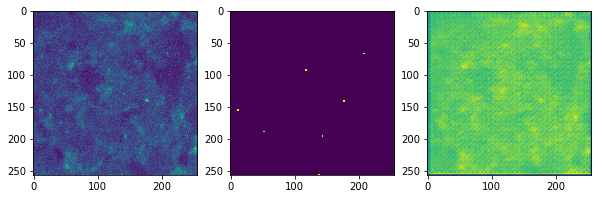

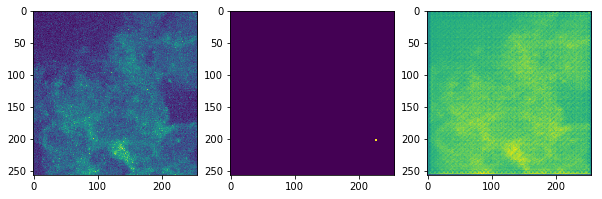

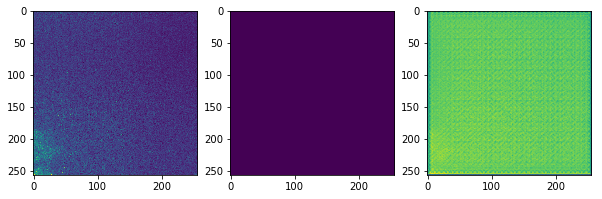

330
Training loss:  0.159944
(50, 256, 256, 1)
Validation loss:  0.094365


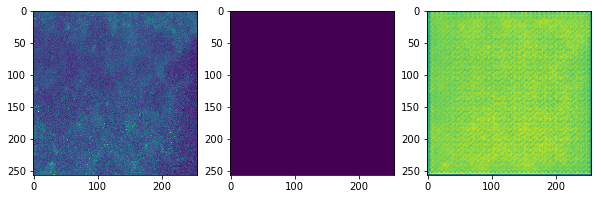

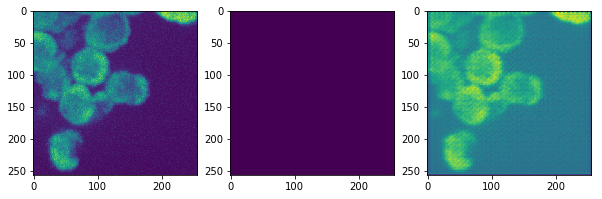

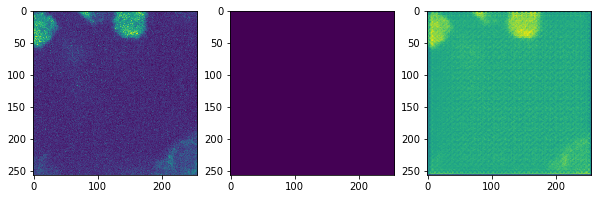

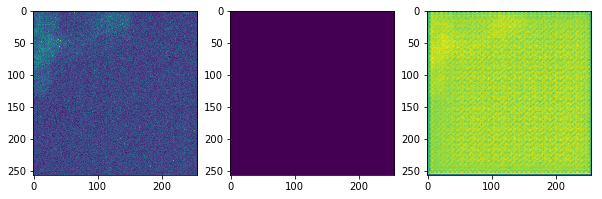

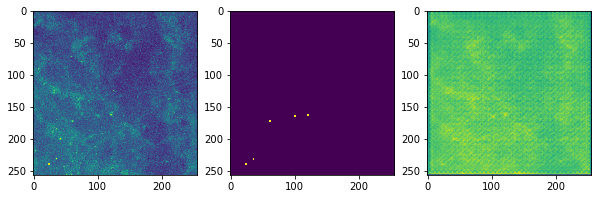

360
Training loss:  0.171332
(50, 256, 256, 1)
Validation loss:  0.109683


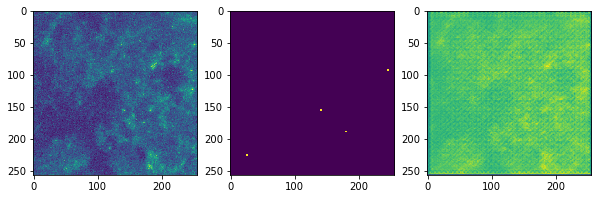

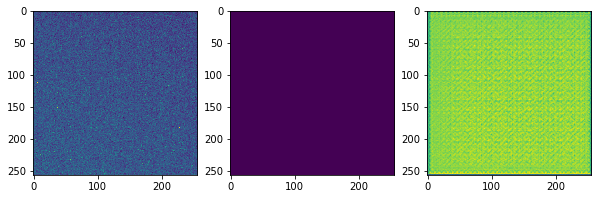

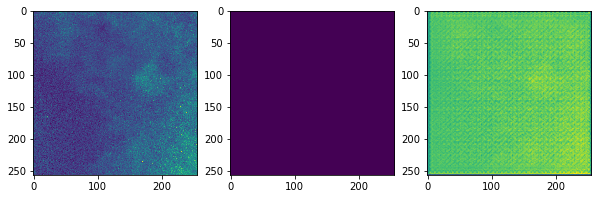

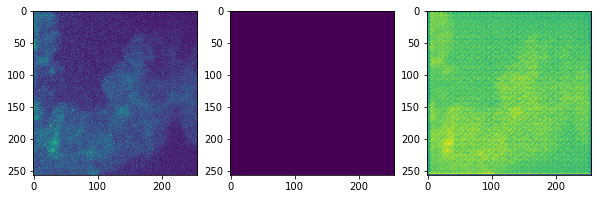

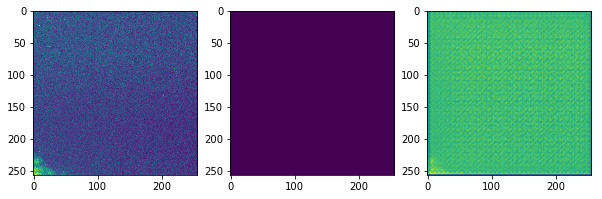

390
Training loss:  0.141142
(50, 256, 256, 1)
Validation loss:  0.10094


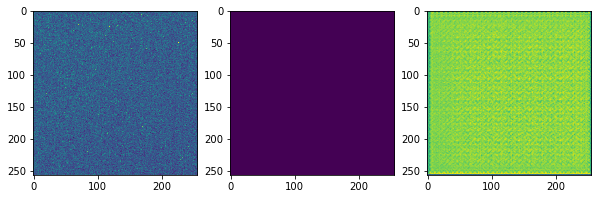

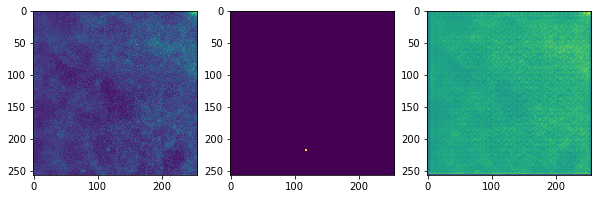

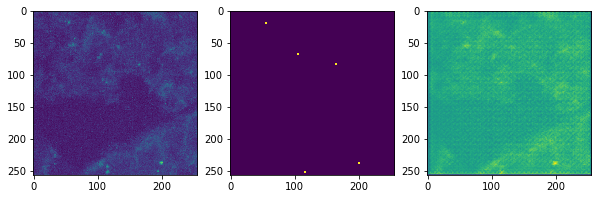

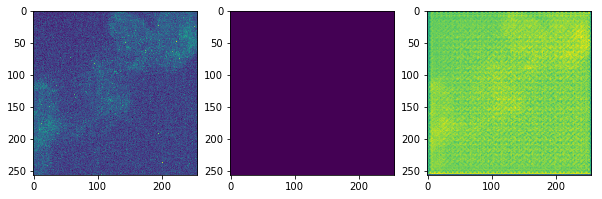

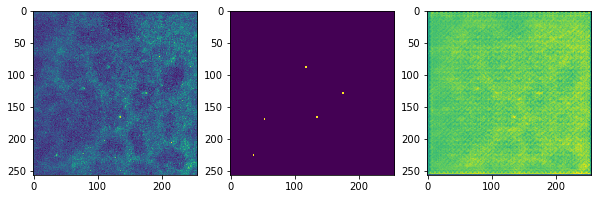

420
Training loss:  0.156558
(50, 256, 256, 1)
Validation loss:  0.0985196


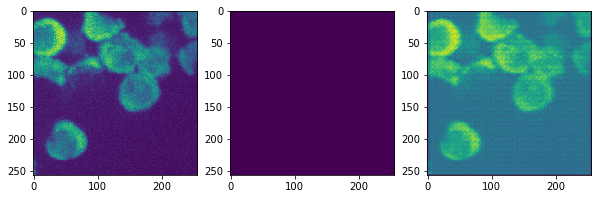

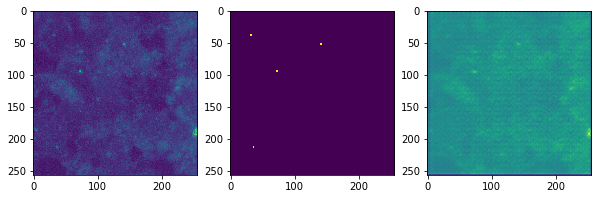

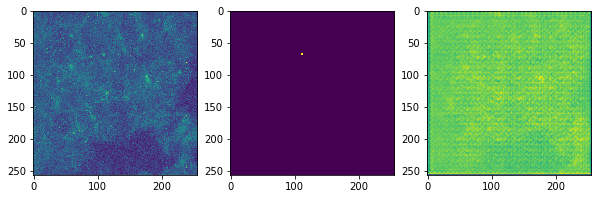

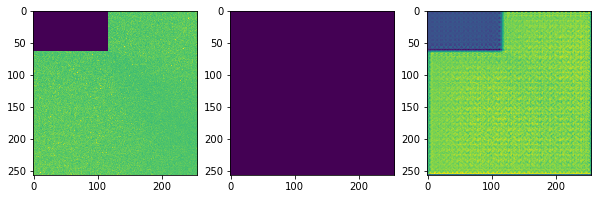

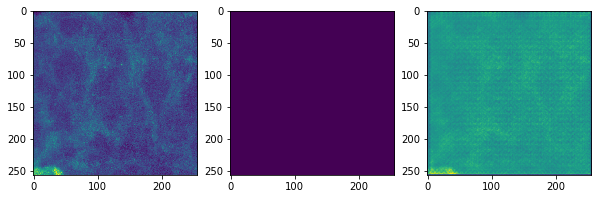

450
Training loss:  0.102134
(50, 256, 256, 1)
Validation loss:  0.133276


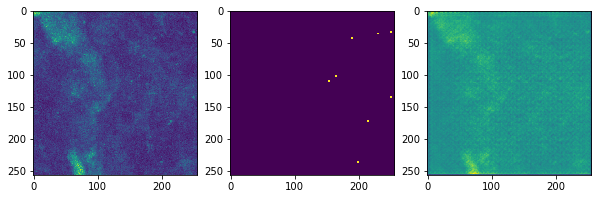

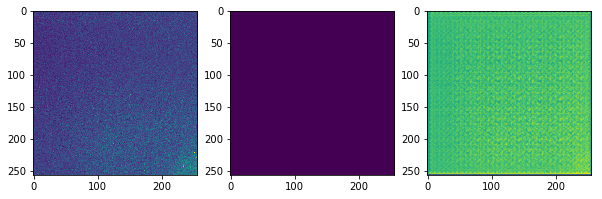

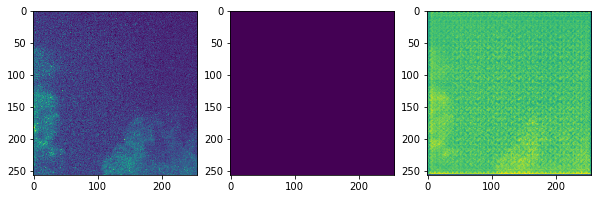

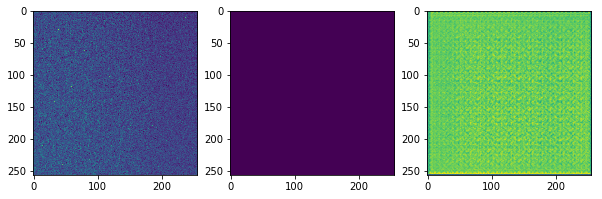

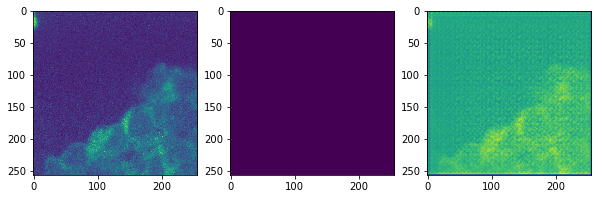

480
Training loss:  0.170607
(50, 256, 256, 1)
Validation loss:  0.13854


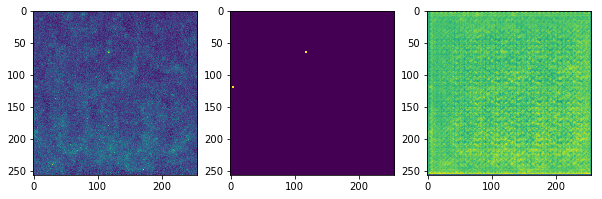

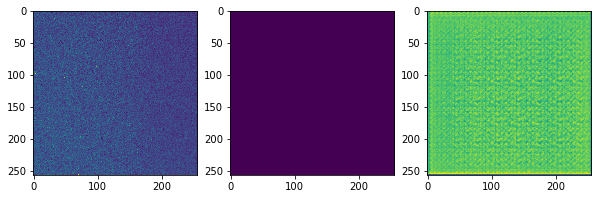

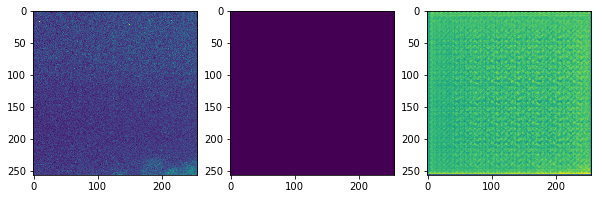

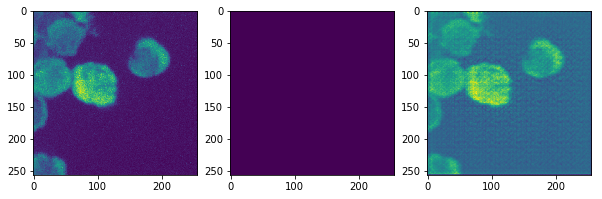

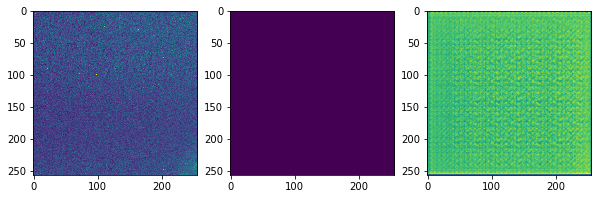

510
Training loss:  0.137484
(50, 256, 256, 1)
Validation loss:  0.07341


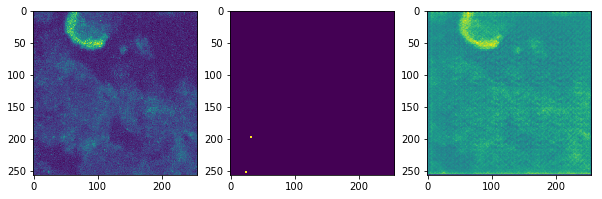

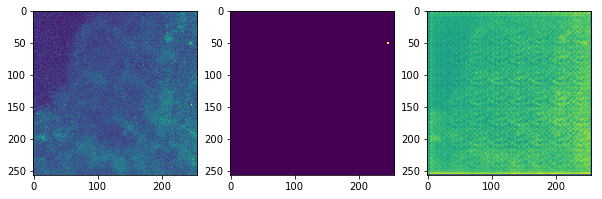

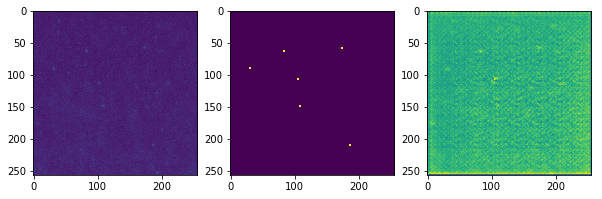

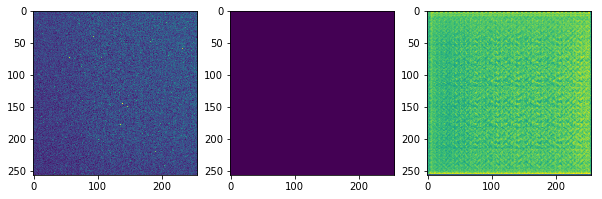

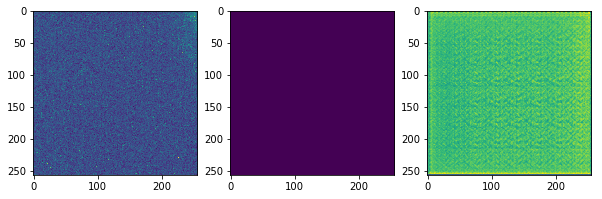

540
Training loss:  0.142449
(50, 256, 256, 1)
Validation loss:  0.116988


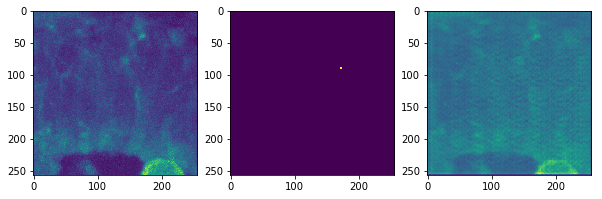

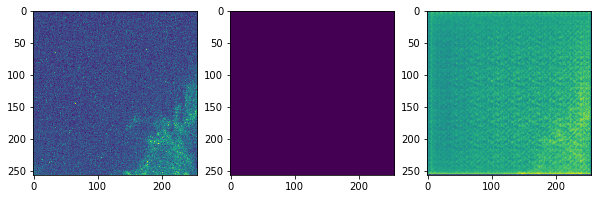

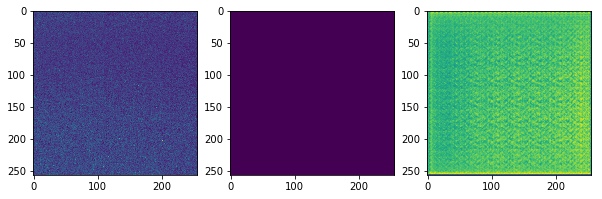

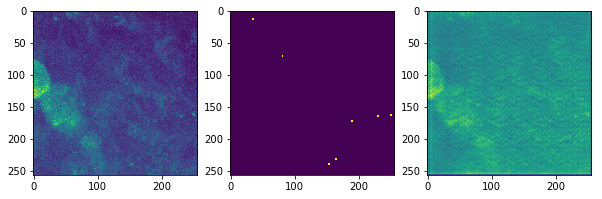

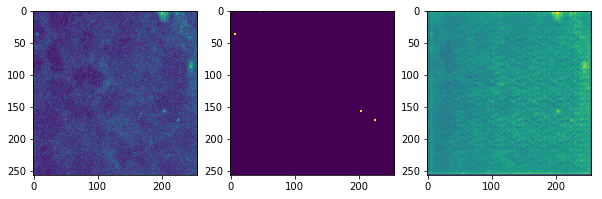

570
Training loss:  0.155959
(50, 256, 256, 1)
Validation loss:  0.0999017


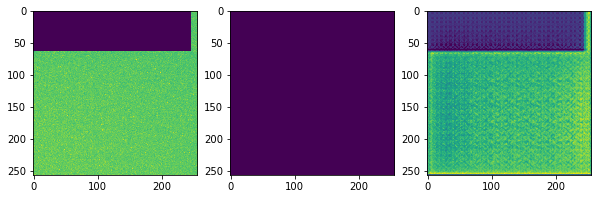

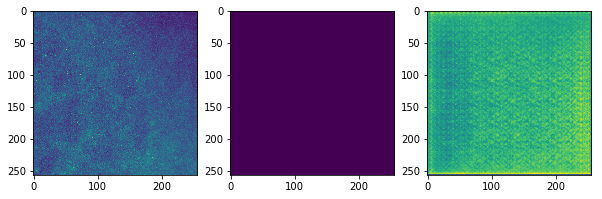

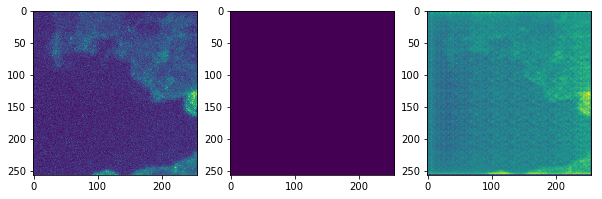

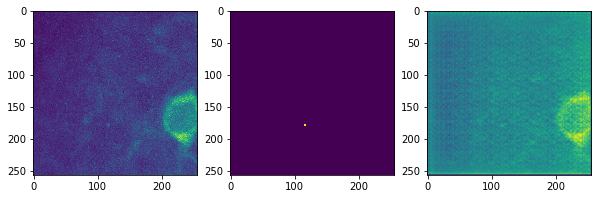

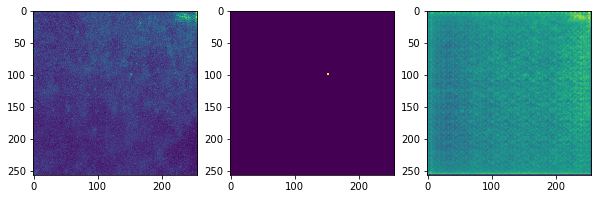

600
Training loss:  0.108312
(50, 256, 256, 1)
Validation loss:  0.116203


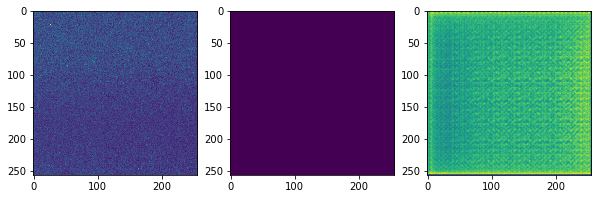

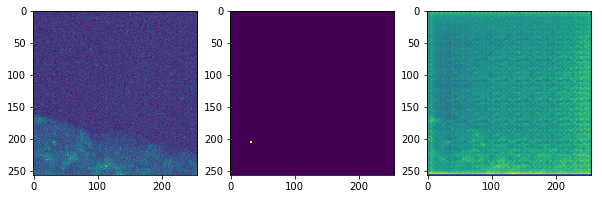

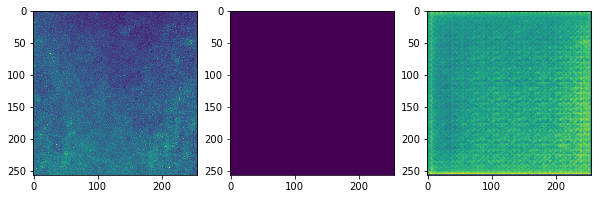

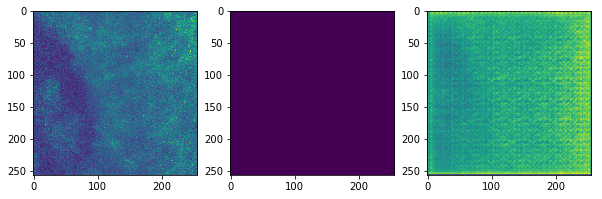

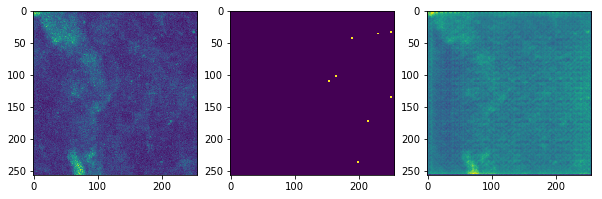

630
Training loss:  0.163853
(50, 256, 256, 1)
Validation loss:  0.128226


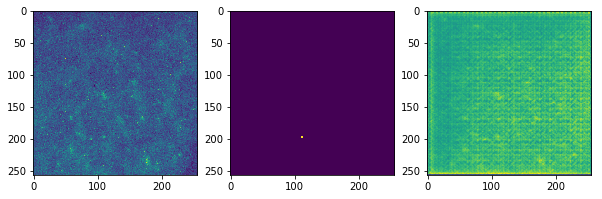

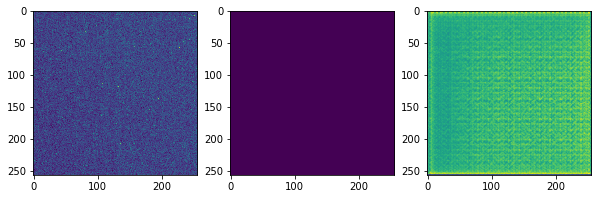

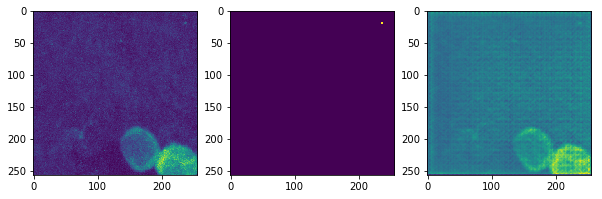

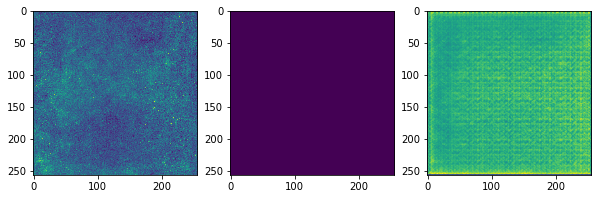

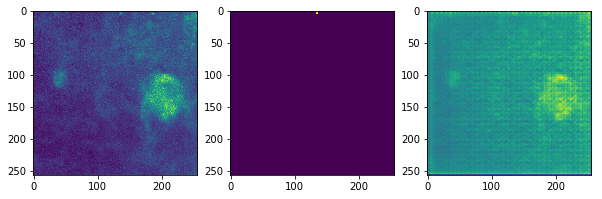

660
Training loss:  0.11535
(50, 256, 256, 1)
Validation loss:  0.0952708


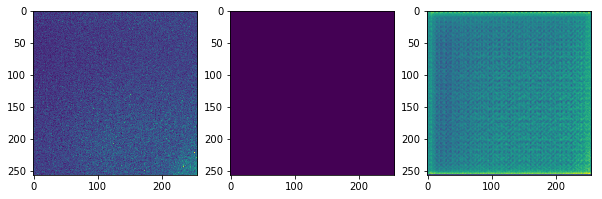

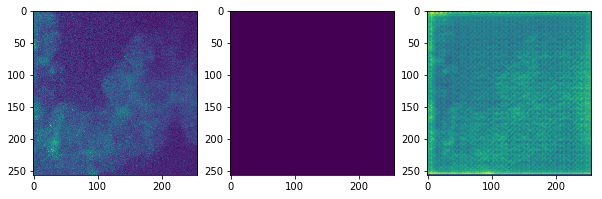

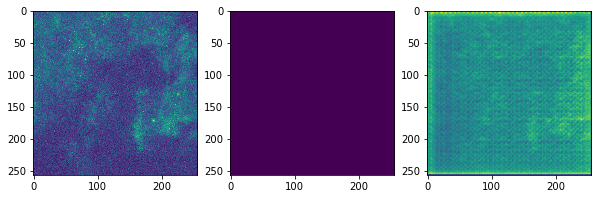

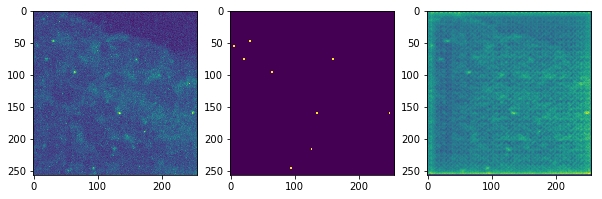

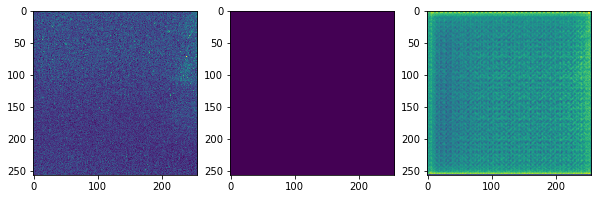

690
Training loss:  0.124899
(50, 256, 256, 1)
Validation loss:  0.138718


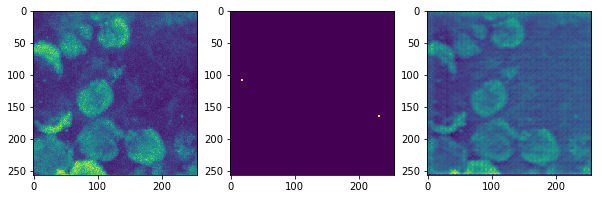

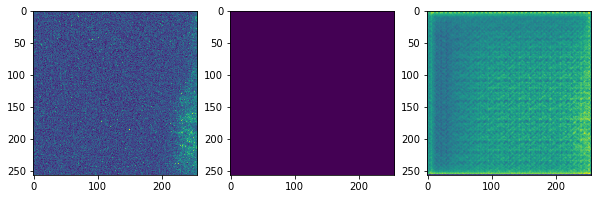

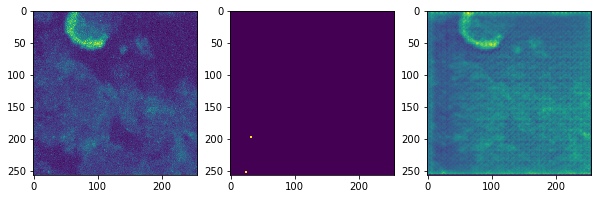

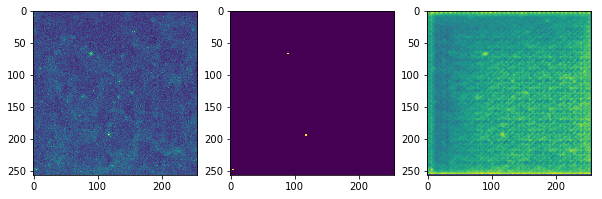

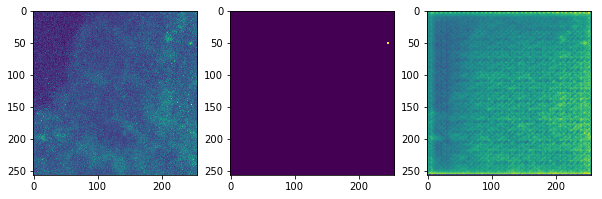

720
Training loss:  0.148877
(50, 256, 256, 1)
Validation loss:  0.103841


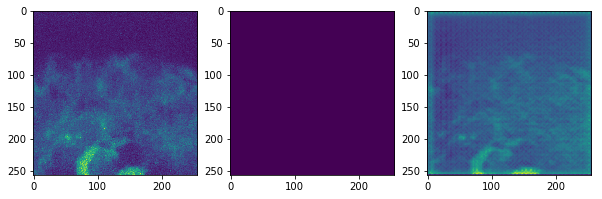

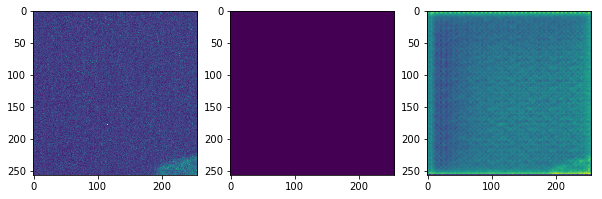

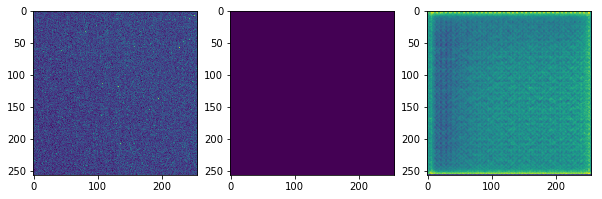

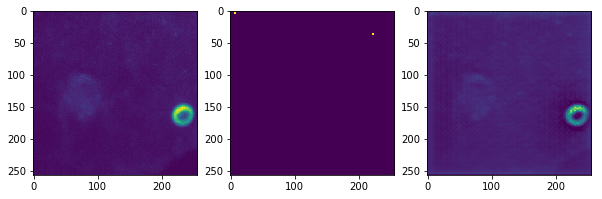

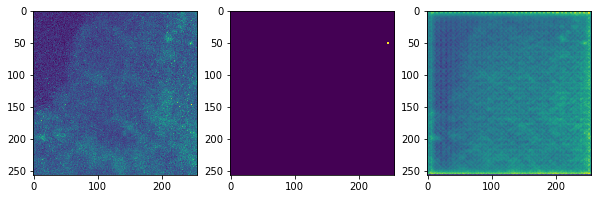

750
Training loss:  0.10602
(50, 256, 256, 1)
Validation loss:  0.0951315


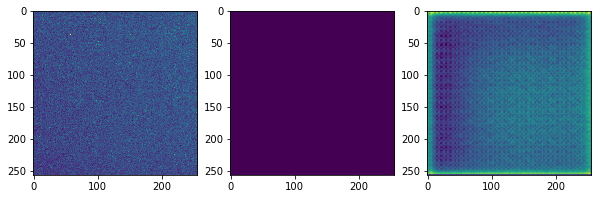

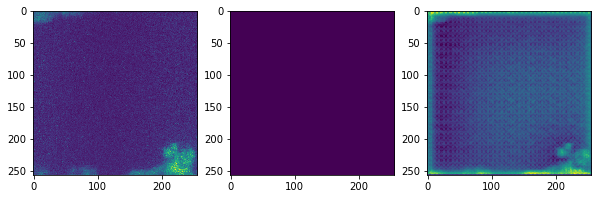

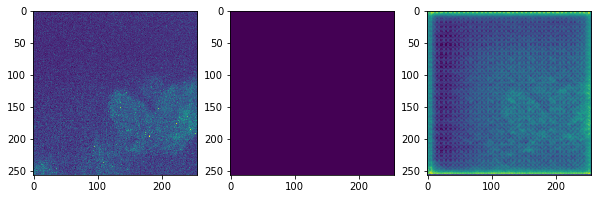

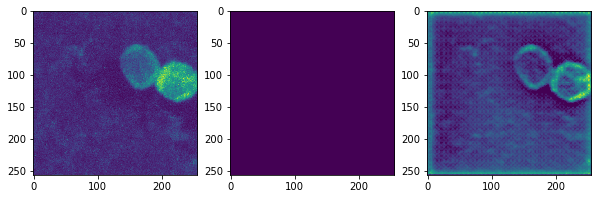

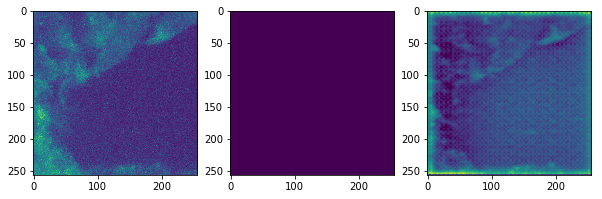

780
Training loss:  0.115769
(50, 256, 256, 1)
Validation loss:  0.0759948


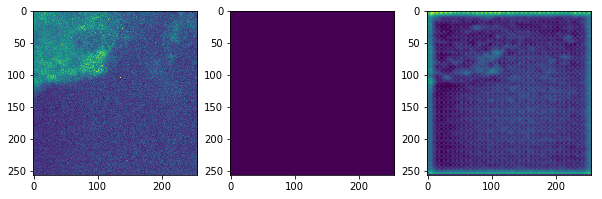

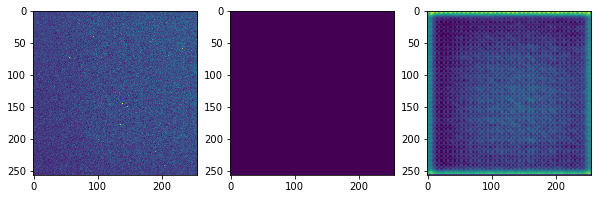

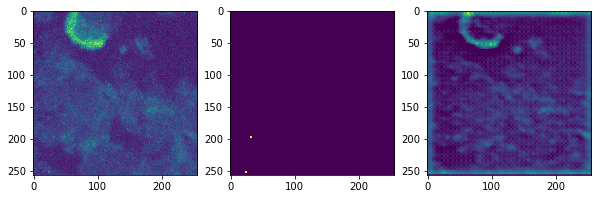

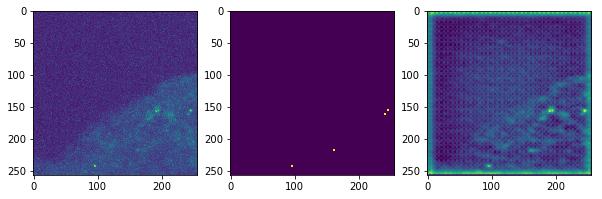

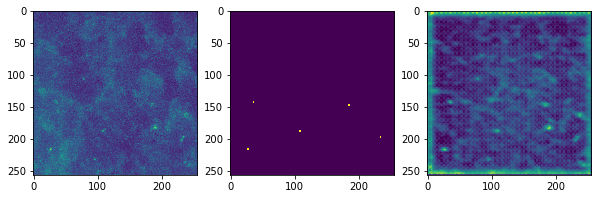

810
Training loss:  0.109072
(50, 256, 256, 1)
Validation loss:  0.086437


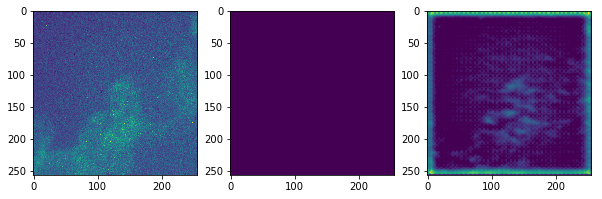

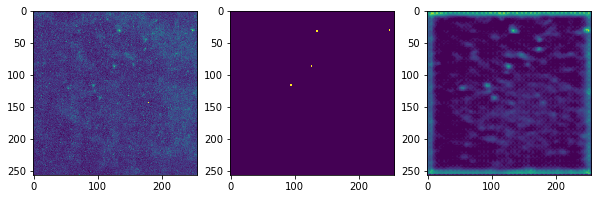

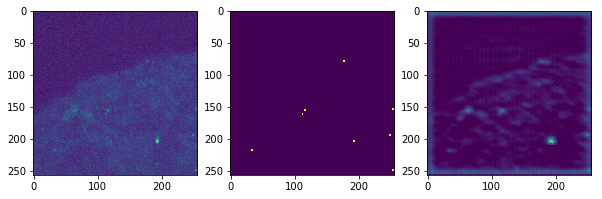

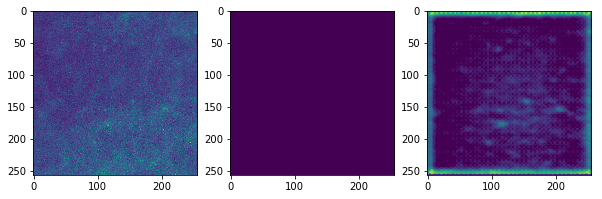

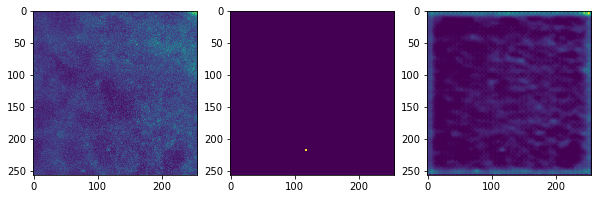

840
Training loss:  0.106325
(50, 256, 256, 1)
Validation loss:  0.0875746


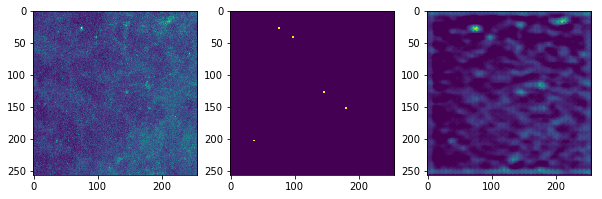

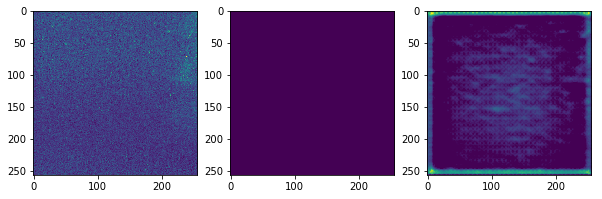

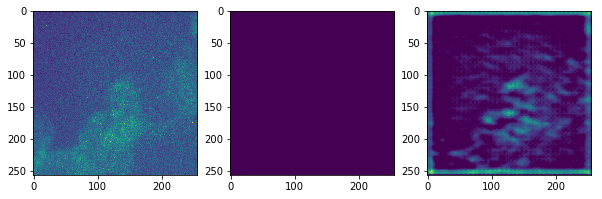

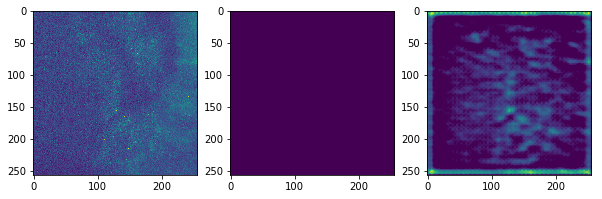

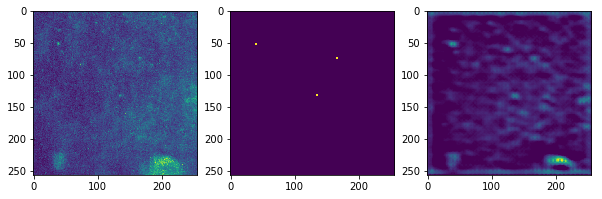

870
Training loss:  0.10182
(50, 256, 256, 1)
Validation loss:  0.0958278


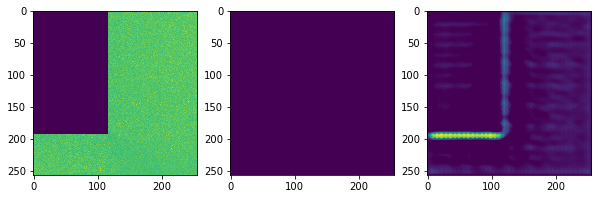

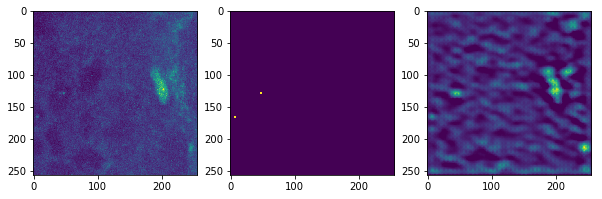

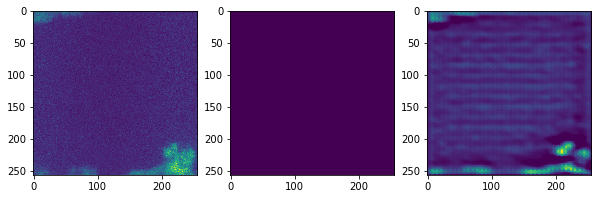

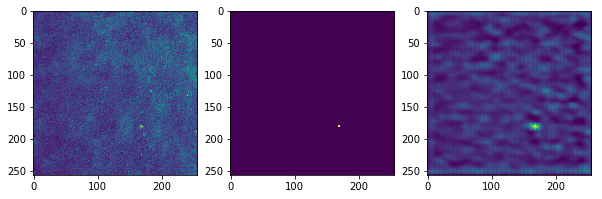

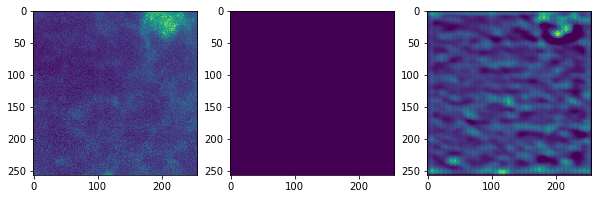

900
Training loss:  0.0970937
(50, 256, 256, 1)
Validation loss:  0.0546268


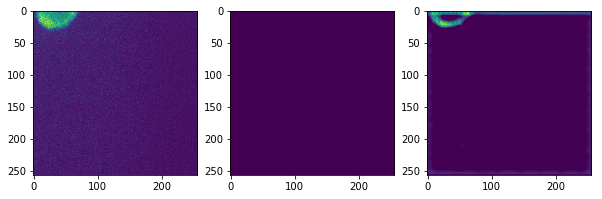

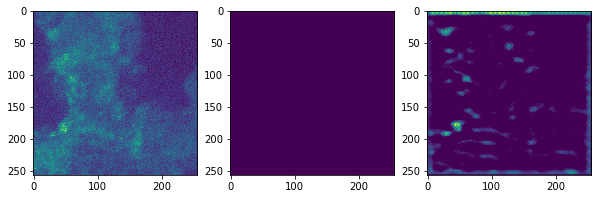

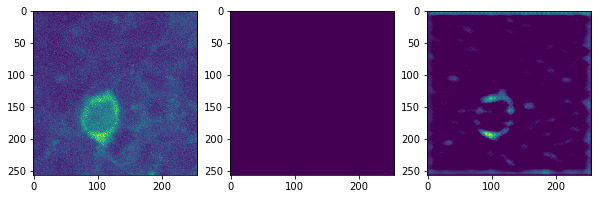

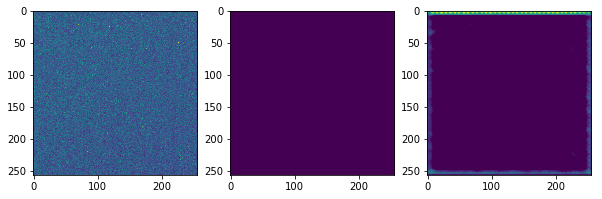

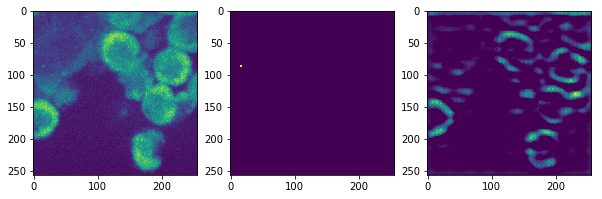

930
Training loss:  0.100107
(50, 256, 256, 1)
Validation loss:  0.0586035


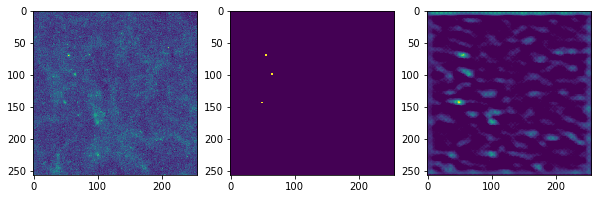

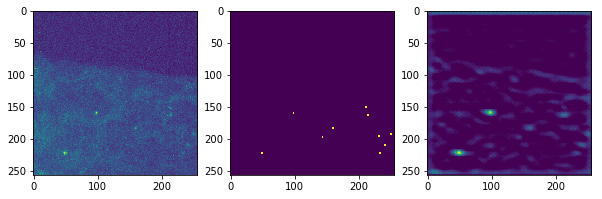

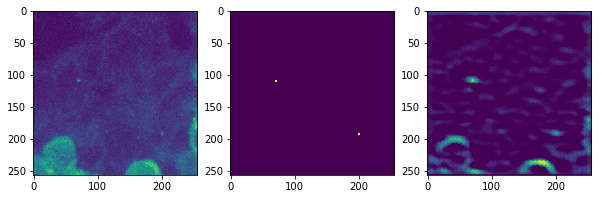

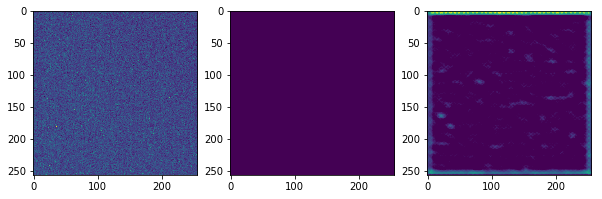

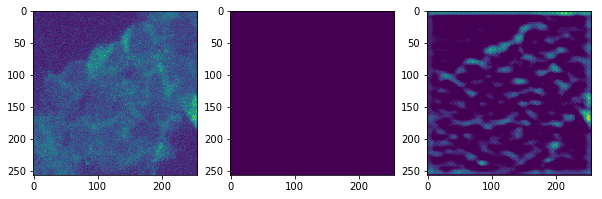

960
Training loss:  0.0908799
(50, 256, 256, 1)
Validation loss:  0.0566406


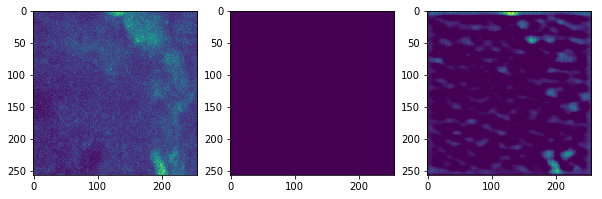

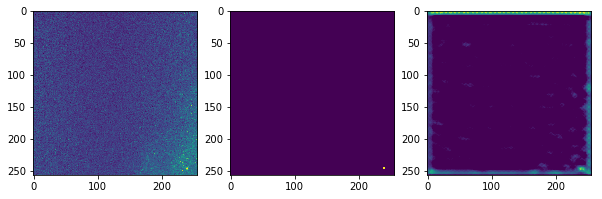

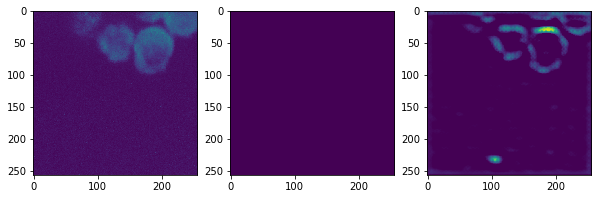

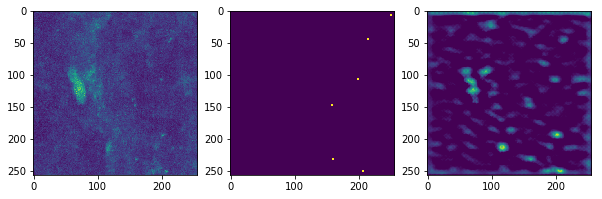

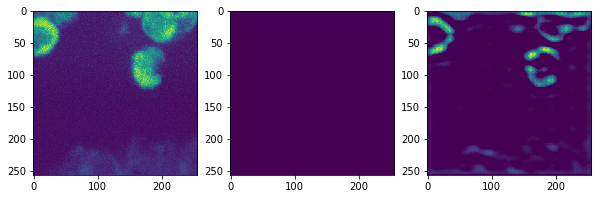

990
Training loss:  0.0787327
(50, 256, 256, 1)
Validation loss:  0.0735788


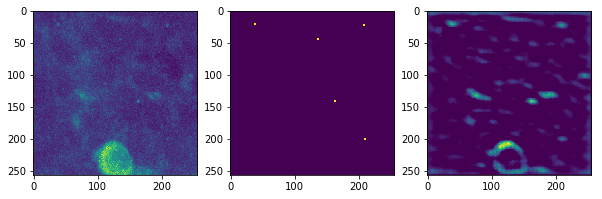

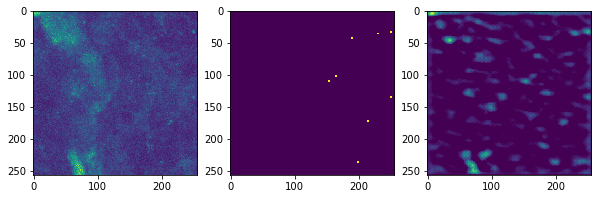

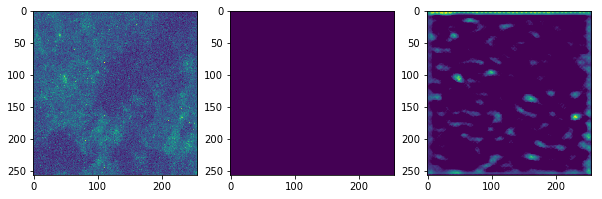

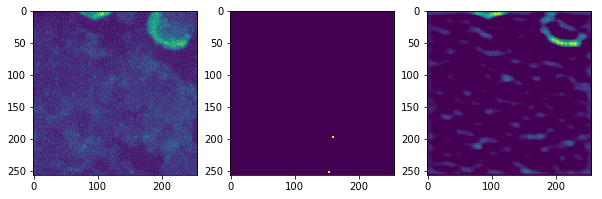

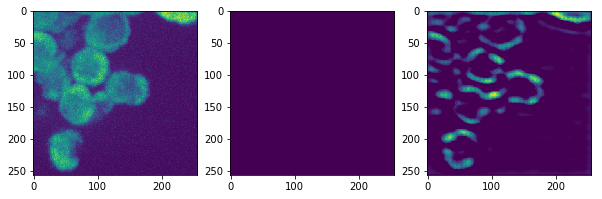

1020
Training loss:  0.0810934
(50, 256, 256, 1)
Validation loss:  0.0504126


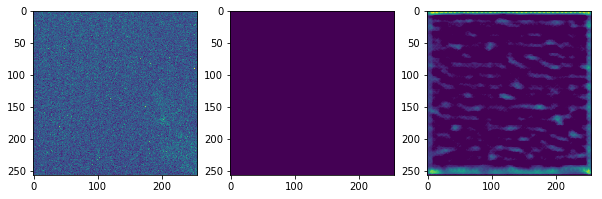

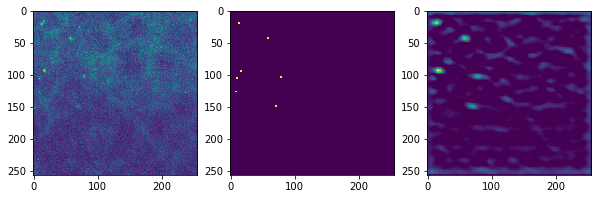

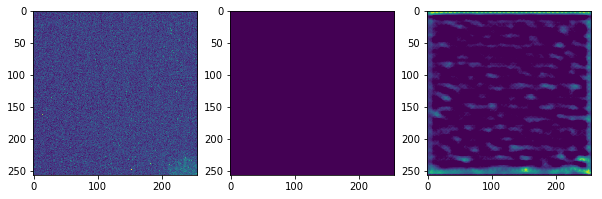

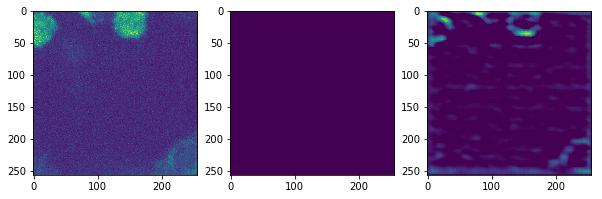

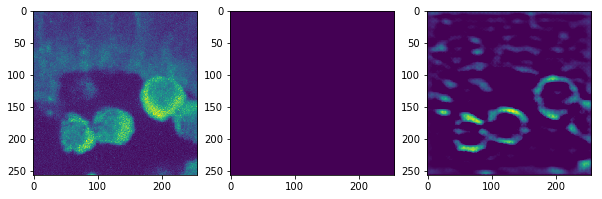

1050
Training loss:  0.0595702
(50, 256, 256, 1)
Validation loss:  0.0436893


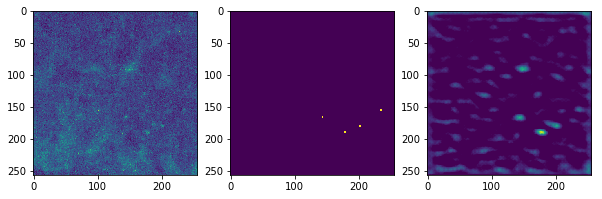

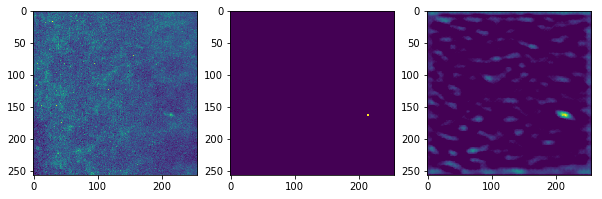

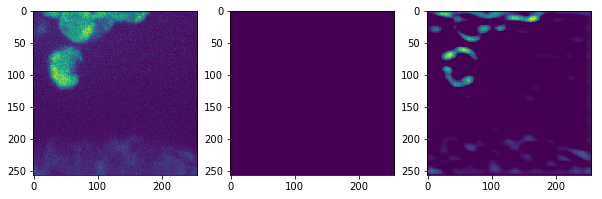

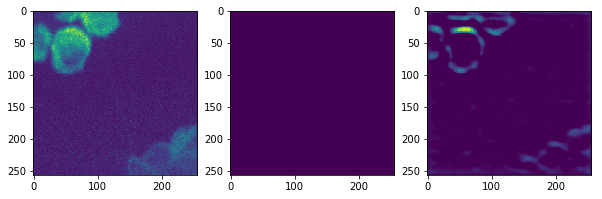

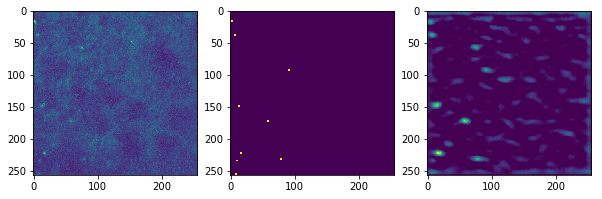

1080
Training loss:  0.081353
(50, 256, 256, 1)
Validation loss:  0.0551989


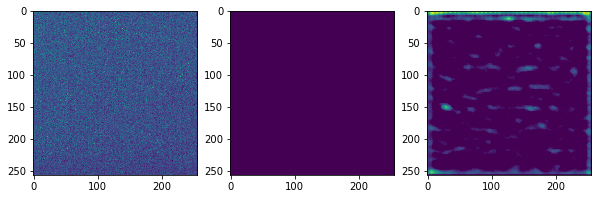

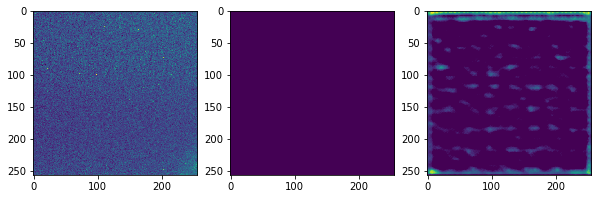

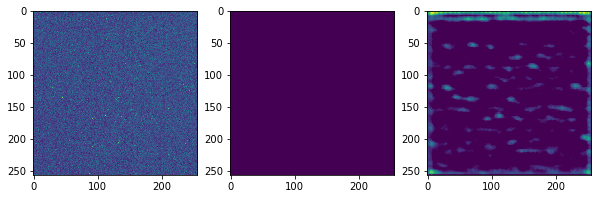

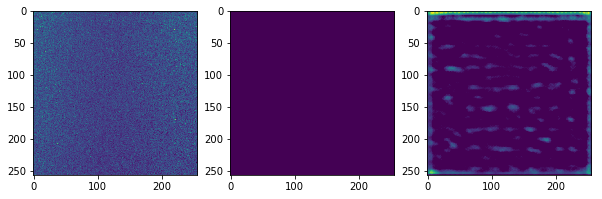

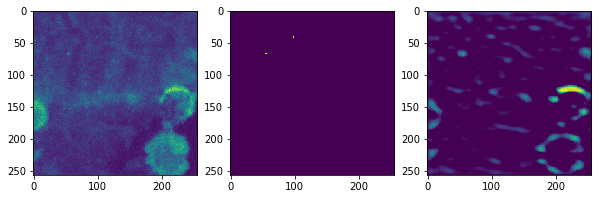

1110
Training loss:  0.0756352
(50, 256, 256, 1)
Validation loss:  0.0473083


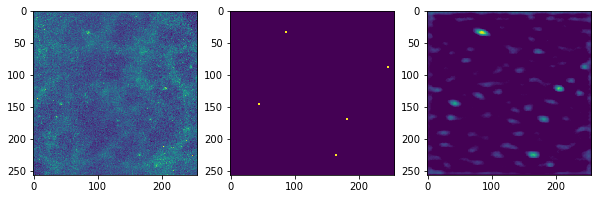

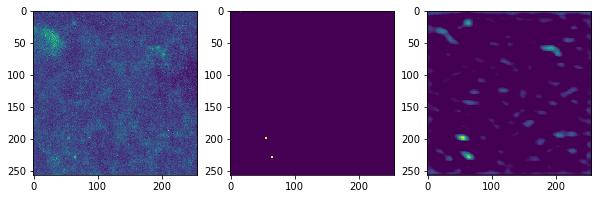

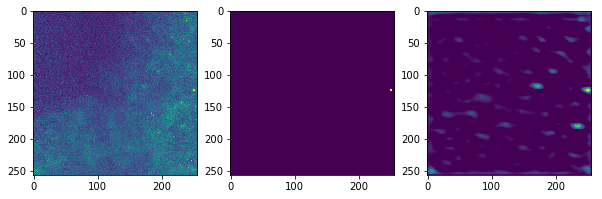

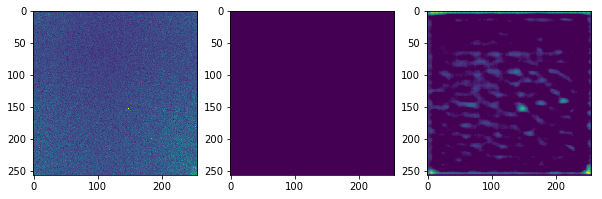

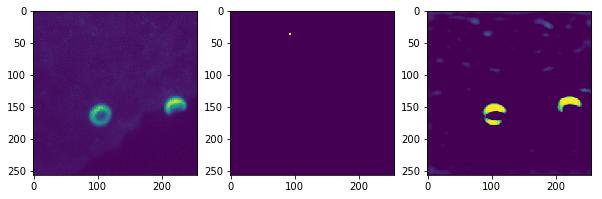

1140
Training loss:  0.053544
(50, 256, 256, 1)
Validation loss:  0.0559281


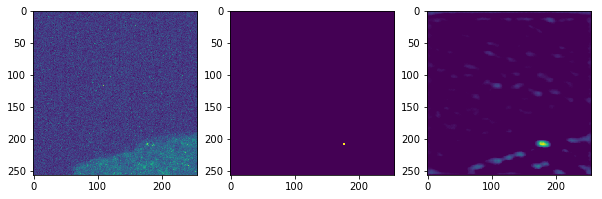

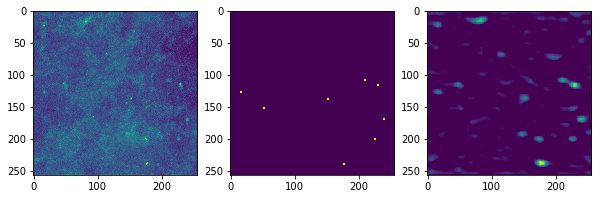

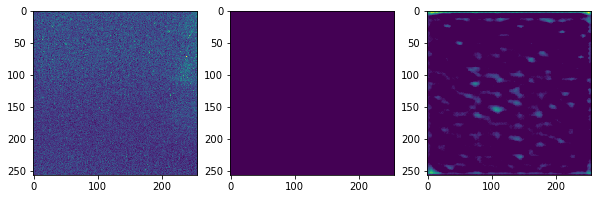

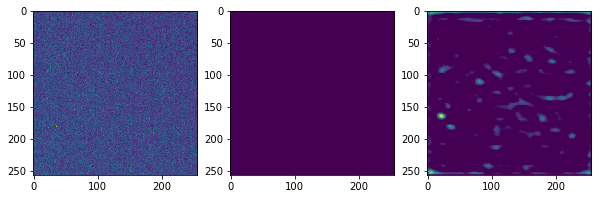

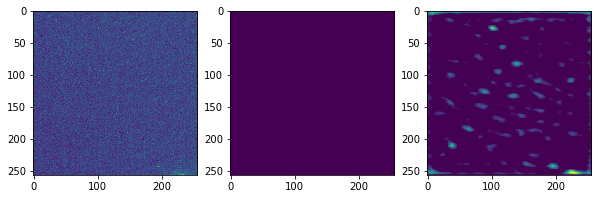

1170
Training loss:  0.0629508
(50, 256, 256, 1)
Validation loss:  0.0528039


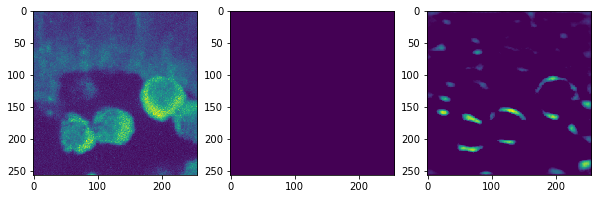

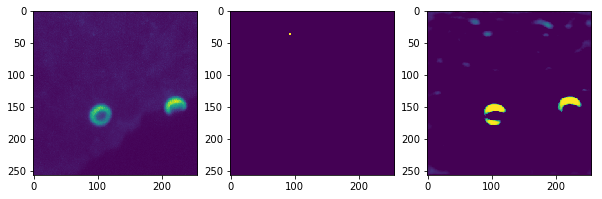

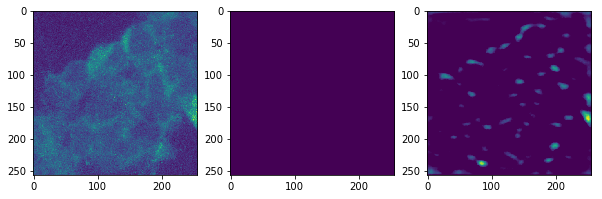

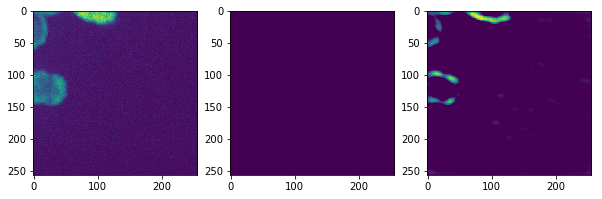

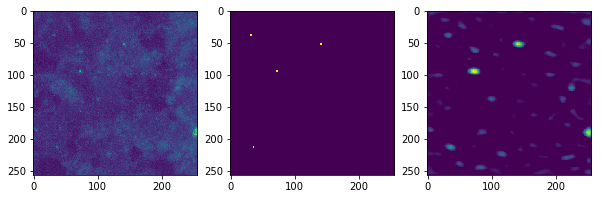

1200
Training loss:  0.048704
(50, 256, 256, 1)
Validation loss:  0.0417876


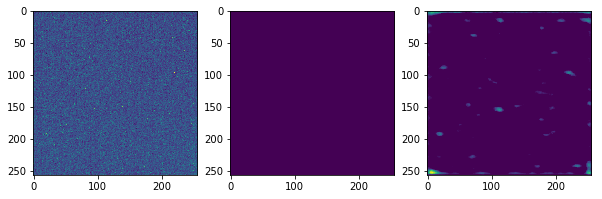

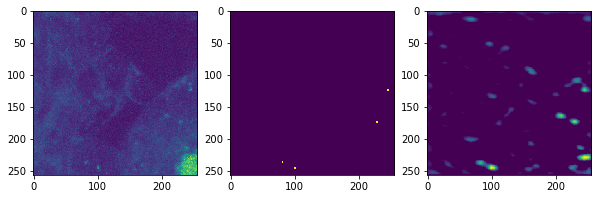

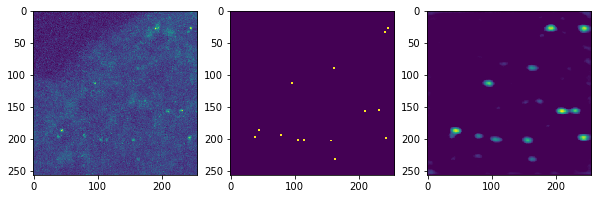

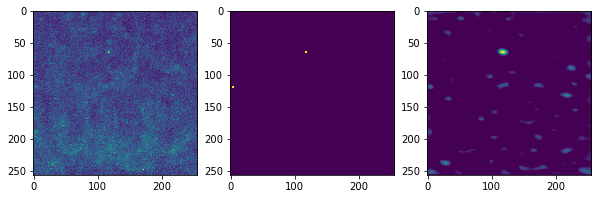

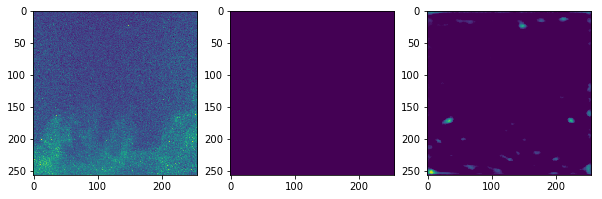

1230
Training loss:  0.0469017
(50, 256, 256, 1)
Validation loss:  0.0349515


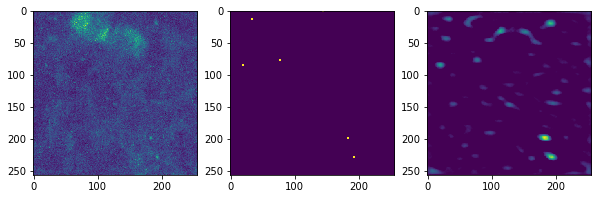

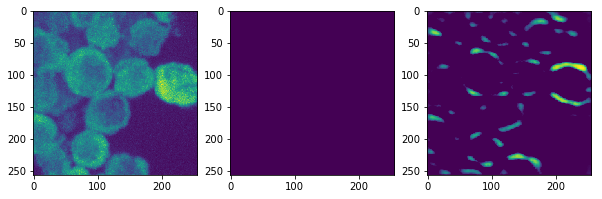

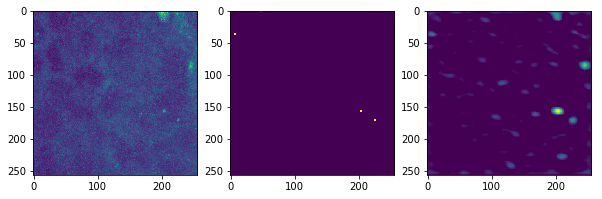

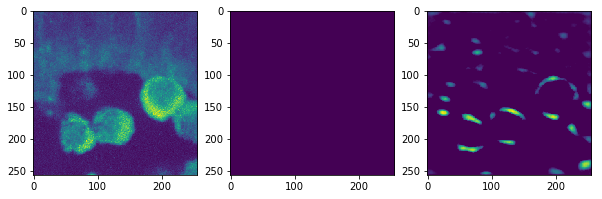

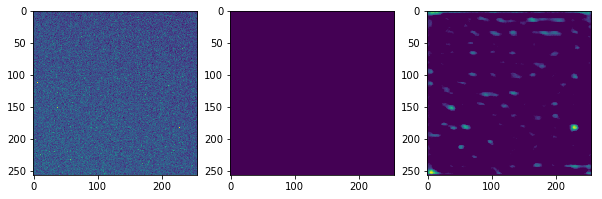

1260
Training loss:  0.0542568
(50, 256, 256, 1)
Validation loss:  0.0433986


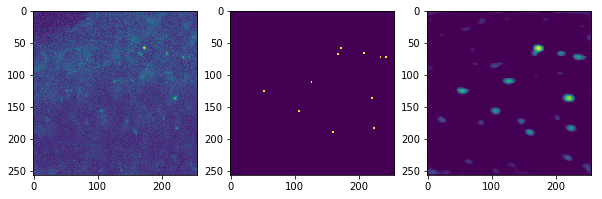

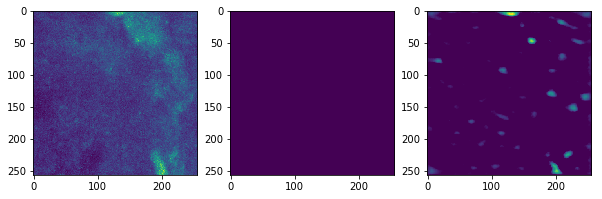

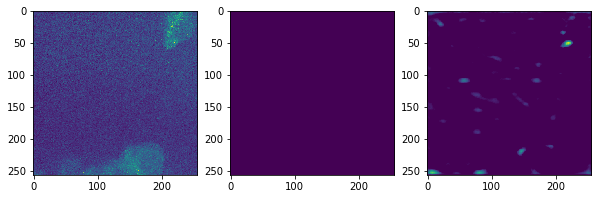

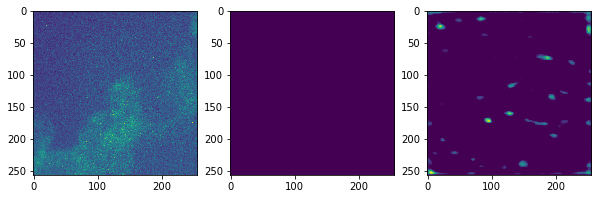

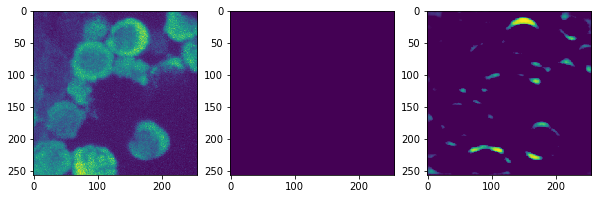

1290
Training loss:  0.0419374
(50, 256, 256, 1)
Validation loss:  0.0311295


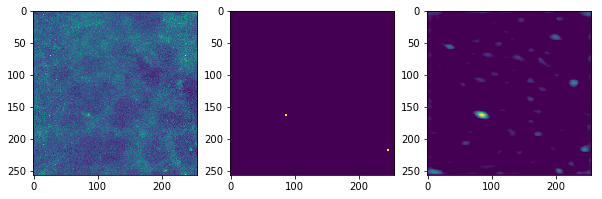

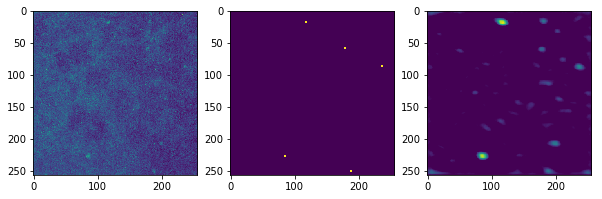

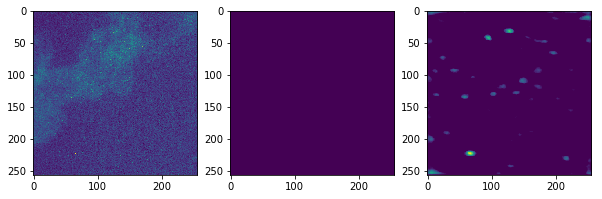

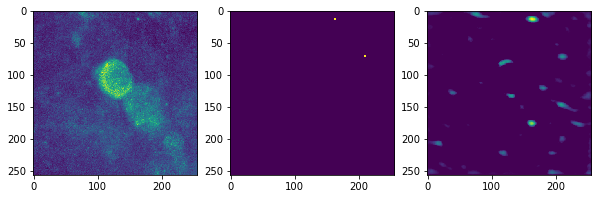

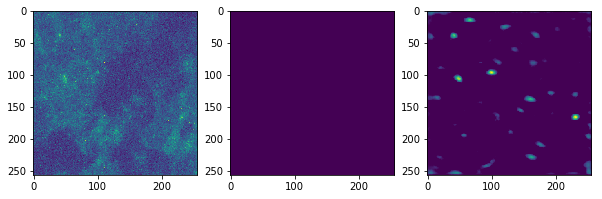

1320
Training loss:  0.0462851
(50, 256, 256, 1)
Validation loss:  0.0521061


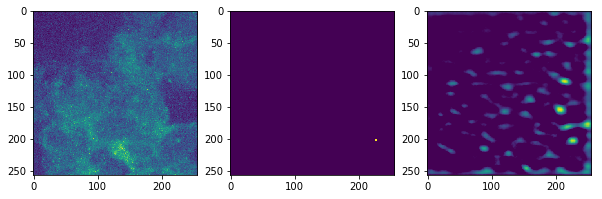

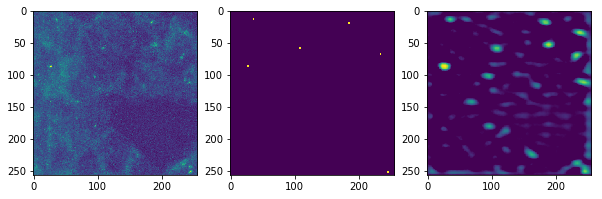

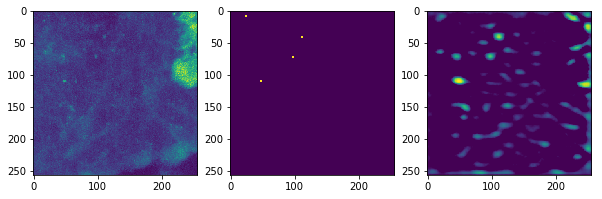

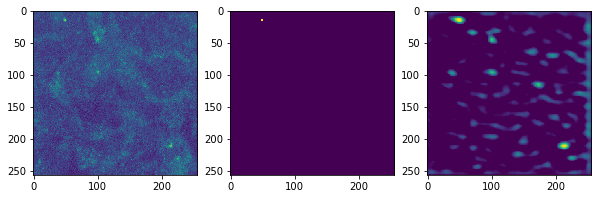

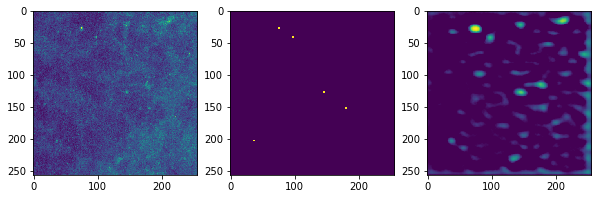

1350
Training loss:  0.0629701
(50, 256, 256, 1)
Validation loss:  0.0546924


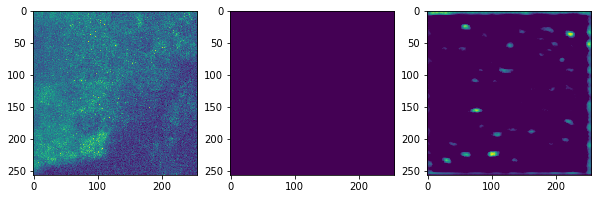

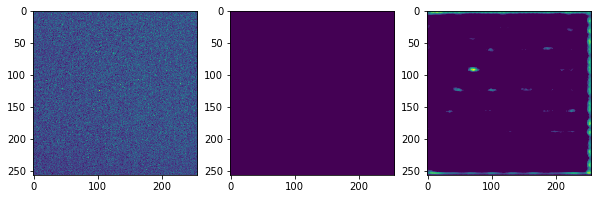

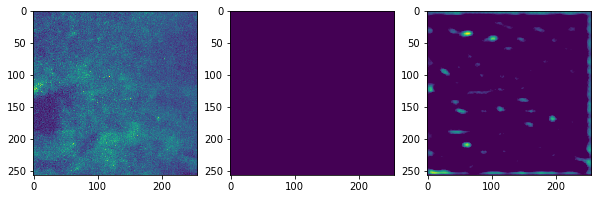

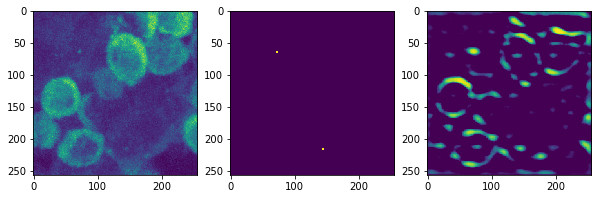

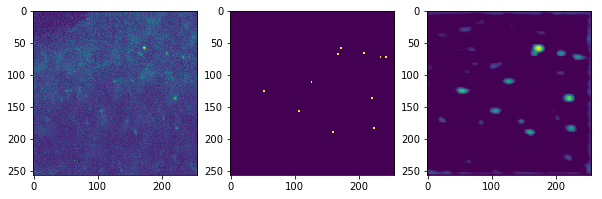

1380
Training loss:  0.0704205
(50, 256, 256, 1)
Validation loss:  0.0371654


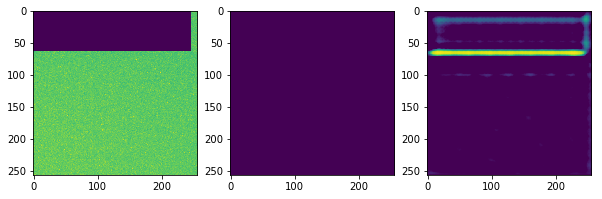

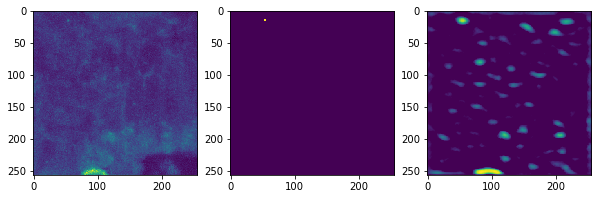

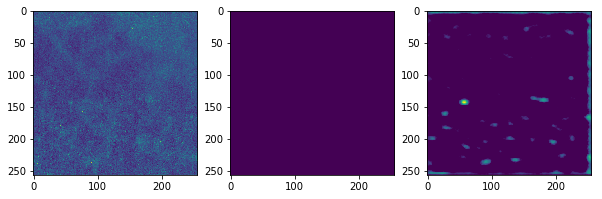

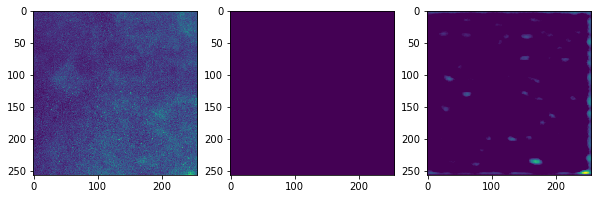

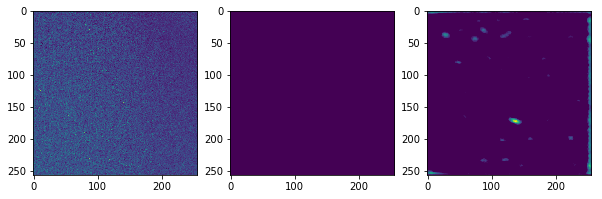

1410
Training loss:  0.0534401
(50, 256, 256, 1)
Validation loss:  0.0421032


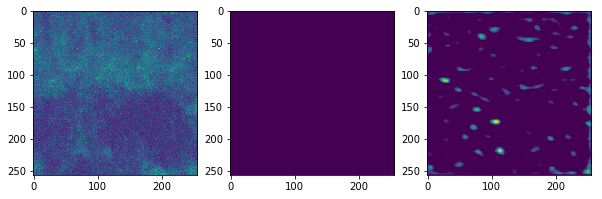

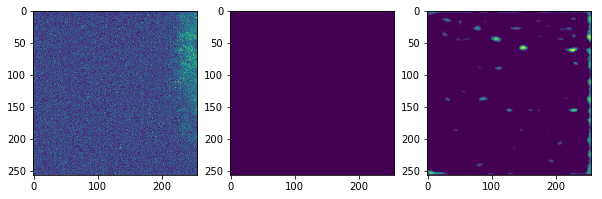

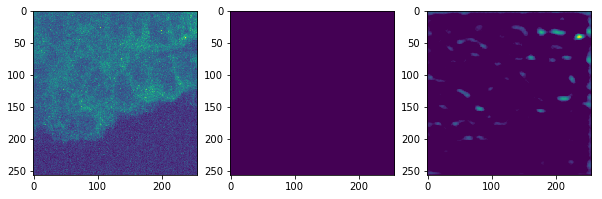

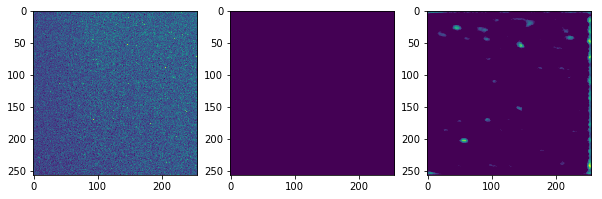

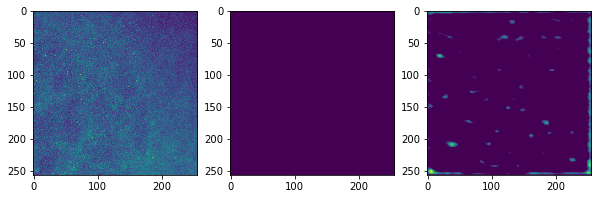

KeyboardInterrupt: 

In [12]:
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())

for i in range(20000):
    idx=np.random.choice(train_data.shape[0], replace=False, size=[50])
    cur_train=train_data[idx,:,:,:]
    cur_truth=train_truth[idx,:,:,:]
    _,results, losses=sess.run([train_op, probs,loss], feed_dict={x:cur_train, y:cur_truth})
    if (i%30==0):
        print(i)
        print("Training loss: ",losses)
        idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
        #idx=range(0,300)
        sub_validation_data=validation_data[idx, :,:,:]
        sub_validation_truth=validation_truth[idx, :,:,:]
        results, losses, a,c,l=sess.run([probs, loss, A1,C2,logits], feed_dict={x:sub_validation_data, y:sub_validation_truth})
        print(results.shape)
        print("Validation loss: ",losses)
        for ti in range (0,5):
            utils.plot_3x1(sub_validation_data[ti,:,:,0], sub_validation_truth[ti,:,:,0], results[ti,:,:,0])
            plt.show()

In [48]:
results

array([[[[ 0.49486026],
         [ 0.48897484],
         [ 0.48013833],
         ..., 
         [ 0.47332242],
         [ 0.48237205],
         [ 0.48618761]],

        [[ 0.49186742],
         [ 0.48861188],
         [ 0.47178441],
         ..., 
         [ 0.46657947],
         [ 0.47104105],
         [ 0.47618061]],

        [[ 0.47989571],
         [ 0.46584579],
         [ 0.46070319],
         ..., 
         [ 0.43747246],
         [ 0.46594721],
         [ 0.48390907]],

        ..., 
        [[ 0.48161697],
         [ 0.45364156],
         [ 0.44754776],
         ..., 
         [ 0.4118433 ],
         [ 0.45174497],
         [ 0.46401194]],

        [[ 0.47157922],
         [ 0.47289518],
         [ 0.45326388],
         ..., 
         [ 0.44816437],
         [ 0.45003185],
         [ 0.47879216]],

        [[ 0.49729612],
         [ 0.48703521],
         [ 0.47590455],
         ..., 
         [ 0.46746379],
         [ 0.47153893],
         [ 0.48978189]]],


       [[[ 0.49511

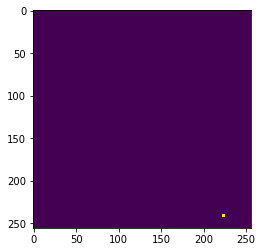

In [22]:
plt.imshow(validation_data[30,:,:,0])

In [ ]:
plt.imshow(l[0,:,:,1])

In [17]:
fy

array([[ 0.,  1.],
       [ 0.,  1.],
       [ 0.,  1.],
       ..., 
       [ 0.,  1.],
       [ 0.,  1.],
       [ 0.,  1.]], dtype=float32)

In [18]:
f

array([[ nan,  nan],
       [ nan,  nan],
       [ nan,  nan],
       ..., 
       [ nan,  nan],
       [ nan,  nan],
       [ nan,  nan]], dtype=float32)

In [186]:
results

array([[[[ 0.36610866,  0.63389134],
         [ 0.26744828,  0.73255169],
         [ 0.20564134,  0.79435867],
         ..., 
         [ 0.13015303,  0.869847  ],
         [ 0.13295171,  0.86704826],
         [ 0.32297096,  0.67702907]],

        [[ 0.24697486,  0.75302511],
         [ 0.21293353,  0.78706646],
         [ 0.12158038,  0.87841964],
         ..., 
         [ 0.11960449,  0.88039547],
         [ 0.10196435,  0.89803559],
         [ 0.2173124 ,  0.7826876 ]],

        [[ 0.18438588,  0.81561416],
         [ 0.14147128,  0.85852873],
         [ 0.09163031,  0.90836972],
         ..., 
         [ 0.08458525,  0.91541475],
         [ 0.12090988,  0.87909019],
         [ 0.22679508,  0.77320486]],

        ..., 
        [[ 0.17338894,  0.8266111 ],
         [ 0.10552993,  0.8944701 ],
         [ 0.11089786,  0.88910216],
         ..., 
         [ 0.03059623,  0.9694038 ],
         [ 0.05872071,  0.94127935],
         [ 0.10113563,  0.89886439]],

        [[ 0.19258568,  0.8074

In [184]:
-np.sum(np.log(np.reshape(results, [3276800,2]))*fy, 1)

array([ 0.45587772,  0.31122136,  0.2302202 , ...,  0.32563883,
        0.34853309,  0.50870186], dtype=float32)

In [185]:
ce

array([ 0.5165391 ,  0.39366204,  0.31827304, ...,  0.17087874,
        0.19477108,  0.40132356], dtype=float32)

In [147]:
results

array([[[[ 0.36179286,  0.63820708],
         [ 0.32115418,  0.67884582],
         [ 0.24355581,  0.75644422],
         ..., 
         [ 0.1949539 ,  0.80504614],
         [ 0.29746091,  0.70253909],
         [ 0.3241137 ,  0.67588627]],

        [[ 0.28179979,  0.71820021],
         [ 0.31632683,  0.68367314],
         [ 0.2606875 ,  0.73931253],
         ..., 
         [ 0.18844941,  0.81155056],
         [ 0.16253391,  0.83746606],
         [ 0.2693066 ,  0.73069334]],

        [[ 0.30323827,  0.69676167],
         [ 0.33434519,  0.66565478],
         [ 0.22262615,  0.77737379],
         ..., 
         [ 0.15968657,  0.84031343],
         [ 0.16840656,  0.83159339],
         [ 0.2505033 ,  0.74949664]],

        ..., 
        [[ 0.25043571,  0.74956429],
         [ 0.18686949,  0.8131305 ],
         [ 0.16896699,  0.83103299],
         ..., 
         [ 0.15085165,  0.84914833],
         [ 0.16739188,  0.8326081 ],
         [ 0.20453341,  0.7954666 ]],

        [[ 0.34003577,  0.6599

In [148]:
ce

array([ 0.43745211,  0.37214696,  0.26060736, ...,  0.22187254,
        0.30022681,  0.34632614], dtype=float32)

In [141]:
np.softmax(f)

AttributeError: module 'numpy' has no attribute 'softmax'

In [136]:
l[0,:,:,1]

array([[ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       ..., 
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.]], dtype=float32)

In [137]:
ce

array([ 0.31326166,  0.31326166,  0.31326166, ...,  0.31326166,
        0.31326166,  0.31326166], dtype=float32)

In [131]:
results[0,:,:,0]

array([[ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143],
       [ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143],
       [ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143],
       ..., 
       [ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143],
       [ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143],
       [ 0.26894143,  0.26894143,  0.26894143, ...,  0.26894143,
         0.26894143,  0.26894143]], dtype=float32)

/home/smc/anaconda3/envs/tflow/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


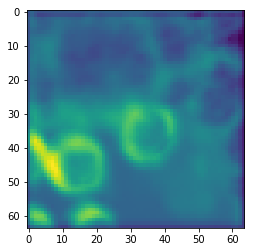

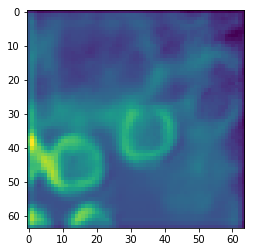

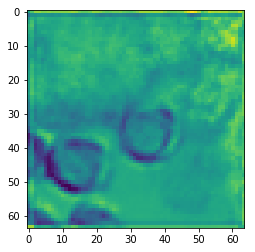

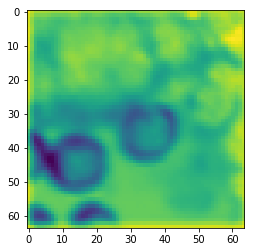

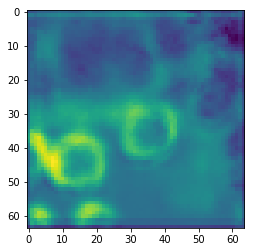

...

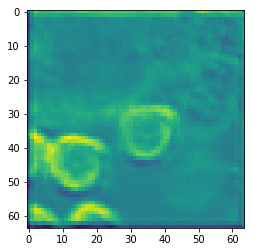

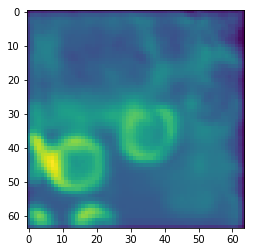

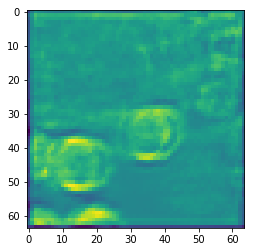

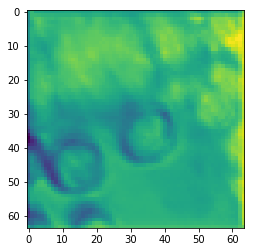

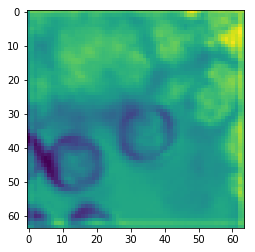

In [75]:
for i in range(0,c.shape[3]):
    plt.figure()
    plt.imshow(c[0,:,:,i])

# Process new data

In [51]:
def process_file(sess, file_name):
    true_test2_data=utils.get_raw_float_image(file_name, [1,256,256,7])[:,:,:,[0]]/4096.0
    true_test2_truth=utils.get_raw_float_image(file_name, [1,256,256,7])[:,:,:,[4]]/255.0
    num_images=true_test2_data.shape[0]
    output=np.zeros([num_images,256,256,3])
    process_batch_size=4
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        sub_validation_data=true_test2_data[t:(t+process_batch_size), :,:,:]
        sub_validation_truth=true_test2_truth[t:(t+process_batch_size), :,:,:]
        results, losses, a=sess.run([probs, loss, A1], feed_dict={x:sub_validation_data, y:sub_validation_truth})
        output[t:(t+process_batch_size),:,:,0]=sub_validation_data[:,:,:,0]
        output[t:(t+process_batch_size),:,:,1]=sub_validation_truth[:,:,:,0]
        output[t:(t+process_batch_size),:,:,2]=results[:,:,:,0]
    output=np.swapaxes(np.swapaxes(output,3,2),2,1)
    np.place(output, output<0, 0)
    (output*255.0).astype(np.uint8).tofile(file_name[0:-4]+'_output.raw')
    print(file_name[0:-4]+'_output.raw')
    return output


In [52]:
output=process_file(sess,data+'Validation7.raw')

/media/smc/RNAFish/DeepLearning/Validation7_output.raw


In [41]:
output.shape

(441, 3, 256, 256)

In [29]:
shp

[4, 512, 512, 4]

In [25]:
np.place(output, output<0, 0)

In [26]:
np.min(output)

0.0

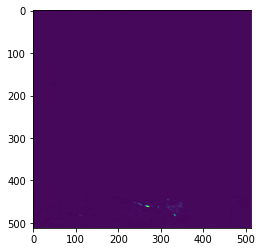

In [19]:
plt.imshow(output[12,2,0,:,:])

In [67]:
true_test2_data=utils.get_raw_float_image(data+'Validation-512.raw', shp)[:,:,:,:,0:2]/16384.0

In [48]:
output.shape

(63, 4, 2, 512, 512)

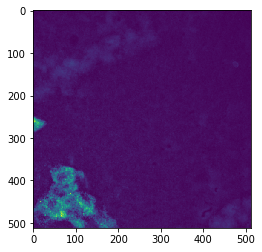

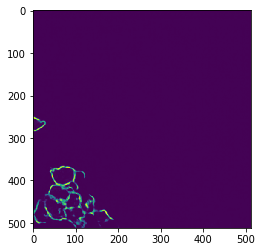

In [75]:
ix=16
plt.imshow(np.max(true_test2_data[ix,:,:,:,0], axis=0))
plt.figure()
plt.imshow(np.max(output[ix,:,0,:,:], axis=0))

In [44]:
tf.saved_model.simple_save(sess, data+'model', inputs={"x":x, "y":y}, outputs={"probs":probs, "loss":loss, "A1":A1})

INFO:tensorflow:Assets added to graph.
INFO:tensorflow:No assets to write.
INFO:tensorflow:SavedModel written to: b'/home/ubuntu/BRS_RNAFish/model/saved_model.pb'


In [ ]:
rest_both=utils.get_raw_float_image(data+'Training-128.raw', shp)
rest_data=rest_both[:,:,:,:,0:2]/16384.0
rest_truth=rest_both[:,:,:,:,2:4]/255.0
rest_both=0

# Trying validation data

In [7]:
sub_range=range(0,3)
sub_validation_data=validation_data[sub_range, :,:,:]
sub_validation_truth=validation_truth[sub_range, :,:,:, :]
results, LN,losses=sess.run([probs, LSQ, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
losses

0.0011763077

36


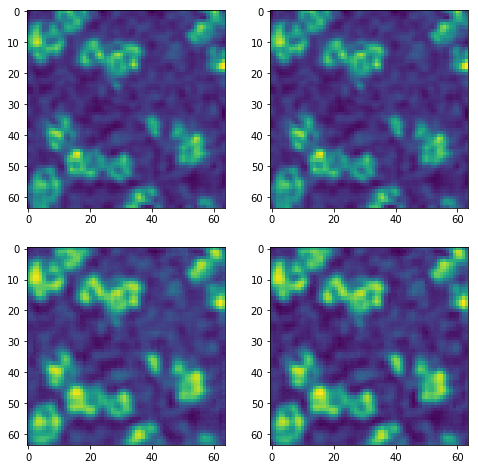

In [10]:
z=2
ix=random.randint(1,90)
print(ix)
ix=0
utils.plot_2x2(sub_validation_data[ix,z,:,:], sub_validation_truth[ix,z,:,:,1], (0.01+results[ix,z,:,:,0]), (0.01+results[ix,z,:,:,1]))
z=z+1



Trying on Bony images

In [94]:
sub_validation_data.shape

(100, 64, 64)

In [56]:
blobs=read_tiff('3DPlanariaD.tif',16)
blobs=blobs.reshape([1,16,64,64])
blobs=(blobs-np.mean(blobs))/np.std(blobs)
blobs=((blobs*.34+0.13))
blobgarb=sub_validation_truth[0:1,:,:,:,:]
print(np.mean(blobs))
print(np.std(blobs))
blobgarb.shape
blobs.shape

0.13
0.3400000000000001


(1, 16, 64, 64)

In [57]:
results, LN,losses=sess.run([probs, LSQ, loss], feed_dict={x:blobs, y:blobgarb})

1

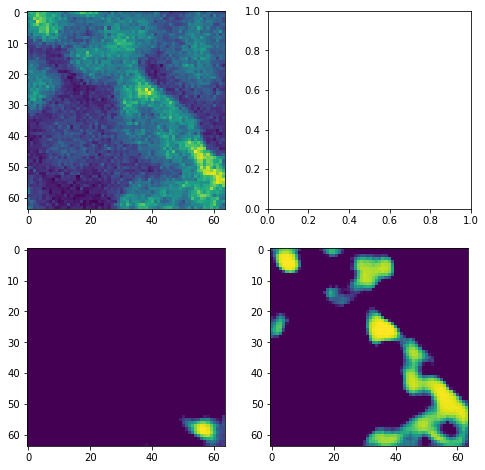

In [58]:
z=5

f,axes=plt.subplots(2,2, figsize=(8,8))
axes[0,0].imshow(blobs[0,z,:,:])
#axes[0,1].imshow(blobgarb[0,:,:,1])
axes[1,0].imshow((0.01+results[0,z,:,:,0]))
axes[1,1].imshow((0.5+results[0,z,:,:,1]))
ix=ix+1
ix

In [59]:
for i in range(0,16):
    im=Image.fromarray(results[0,i,:,:,0])
    im.save('output_planariaDM/MaskB'+str(i)+'.tif', "TIFF")
    im=Image.fromarray(results[0,i,:,:,1])
    im.save('output_planariaDM/OutlineB'+str(i)+'.tif', "TIFF")
